# Step1: Arima trophoblast organoid scRNA-seq analysis

Content:
* 1.Quality control (low quality cells, ribosomal, Malat1, cell cycle)
* 2.Integration of samples
* 3.Clustering and marker genes
* 4.Cell identification
* 5.Sample comparison
* 6.DEG analysis
* 7.GO term enrichment analysis

In [1]:
suppressPackageStartupMessages({
    library(Seurat)
    library(SCP)
    library(SeuratDisk)
    library(SeuratWrappers)
    #library(SeuratData)
    library(patchwork)
    library(ggplot2)
    library(cowplot)
    #theme_set(theme_cowplot())
    library(Matrix)
    
    library(dplyr)
    #library(reticulate)
    #library(MAST)
    #library(velocyto.R)
    #library(monocle3)
    #library(magrittr)
    library(RColorBrewer)
    library(dittoSeq)
    library("clusterProfiler")
    library("org.Hs.eg.db")
    library("AnnotationHub")
})
options(warn=-1)

set.seed(23)

setwd("/work3/SingleCell/Arima")
options(stringsAsFactors = F)
source("src/functions_nagai.R")

In [2]:
color_palette1 <- brewer.pal(7, "Dark2")
color_palette2 <- brewer.pal(12, "Paired")
color_palette <- c(color_palette1, color_palette2)
color_palette
length(color_palette)

[1] "#1B9E77" "#D95F02" "#7570B3" "#E7298A" "#66A61E" "#E6AB02" "#A6761D"
 [8] "#A6CEE3" "#1F78B4" "#B2DF8A" "#33A02C" "#FB9A99" "#E31A1C" "#FDBF6F"
[15] "#FF7F00" "#CAB2D6" "#6A3D9A" "#FFFF99" "#B15928"

[1] 19

In [3]:
#Load first dataset
data1 <- Read10X("data/ari_org/Pre1_con/outs/filtered_feature_bc_matrix/")
so1 <- CreateSeuratObject(counts = data1, project = "Arima_Pre1_con", min.cells = 3, min.features = 200)
so1

An object of class Seurat 
27472 features across 7975 samples within 1 assay 
Active assay: RNA (27472 features, 0 variable features)

In [4]:
#Load second dataset
data2 <- Read10X("data/ari_org/Pre1_hor/outs/filtered_feature_bc_matrix/")
so2 <- CreateSeuratObject(counts = data2, project = "Arima_Pre1_hor", min.cells = 3, min.features = 200)
so2

An object of class Seurat 
27241 features across 3838 samples within 1 assay 
Active assay: RNA (27241 features, 0 variable features)

In [5]:
#Load third dataset
data3 <- Read10X("data/ari_org/EMO6_hor/outs/filtered_feature_bc_matrix/")
so3 <- CreateSeuratObject(counts = data3, project = "Arima_EMO6_hor", min.cells = 3, min.features = 200)
so3

An object of class Seurat 
28369 features across 7588 samples within 1 assay 
Active assay: RNA (28369 features, 0 variable features)

In [6]:
so.list <- c(so1, so2, so3)

[1] "Number of genes with only zero values: 0"
[1] "Number of genes with only 1 or 0 values: 5496"


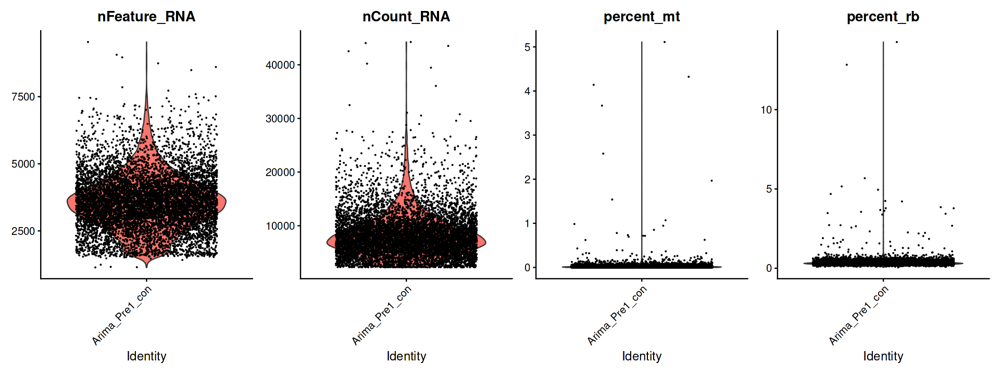

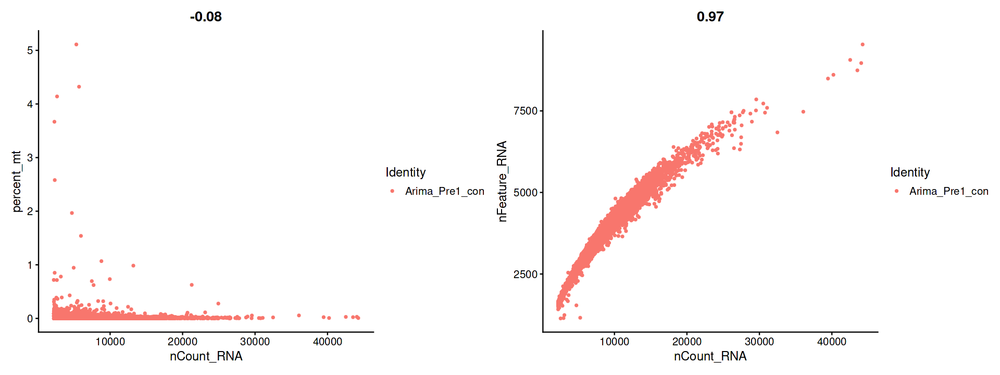

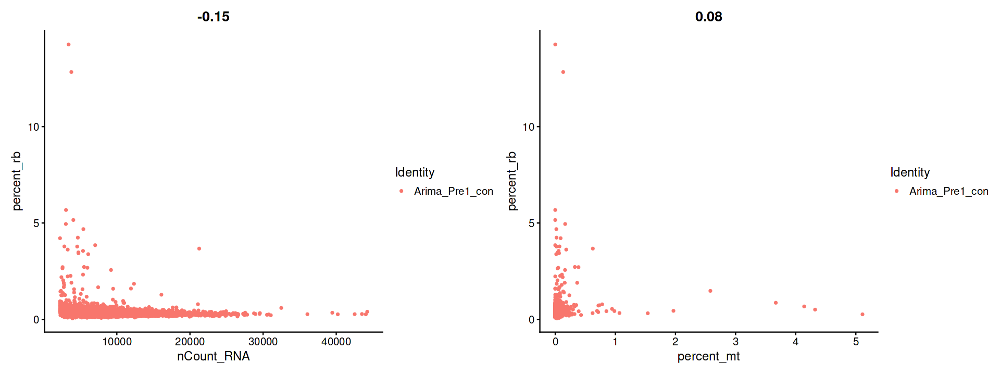

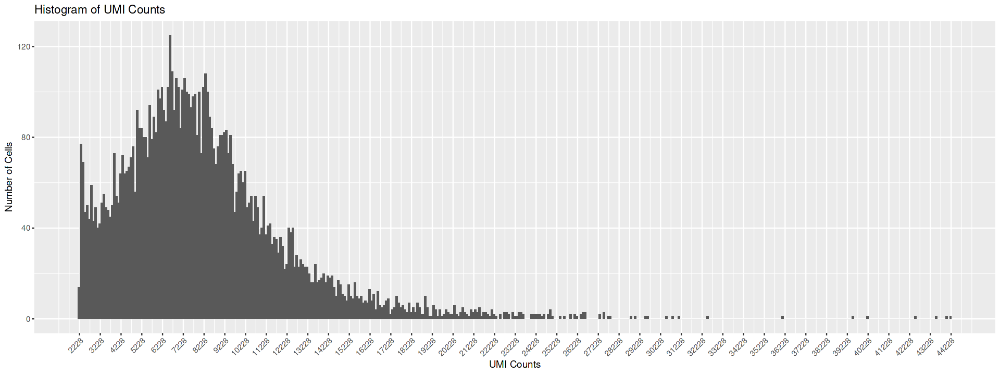

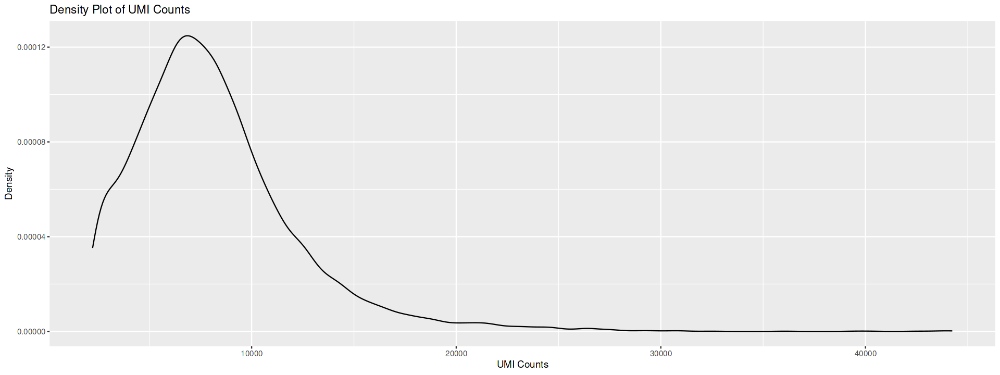

[1] "Number of genes with only zero values: 0"
[1] "Number of genes with only 1 or 0 values: 4701"


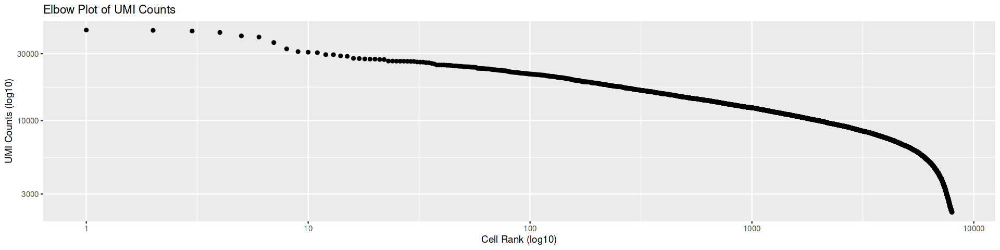

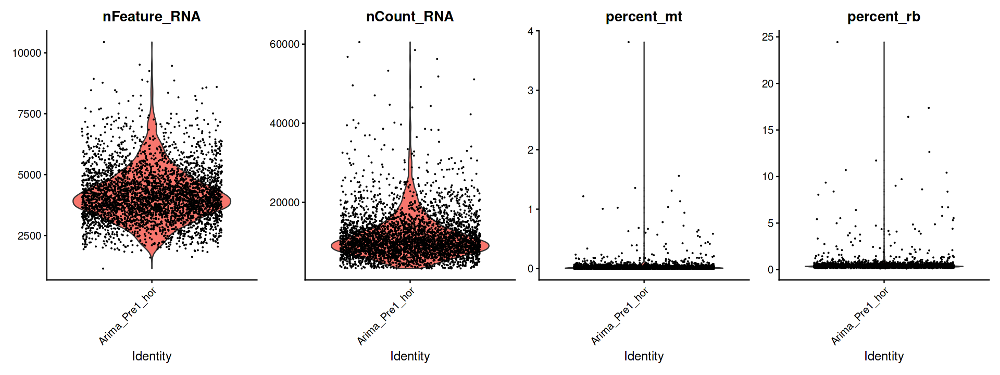

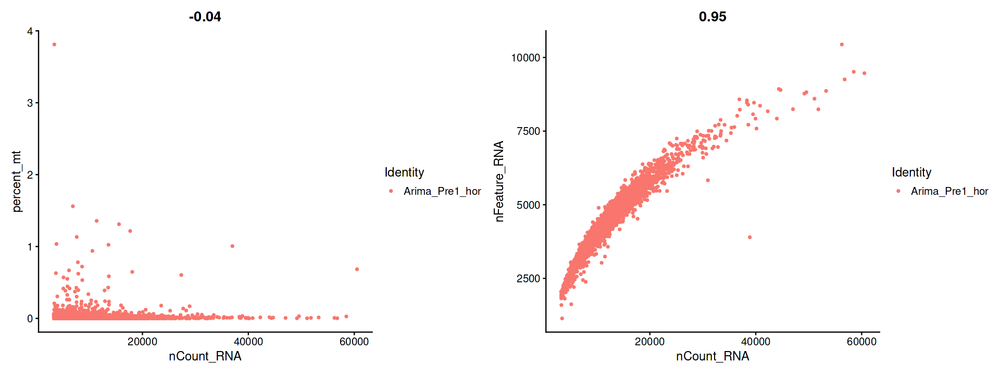

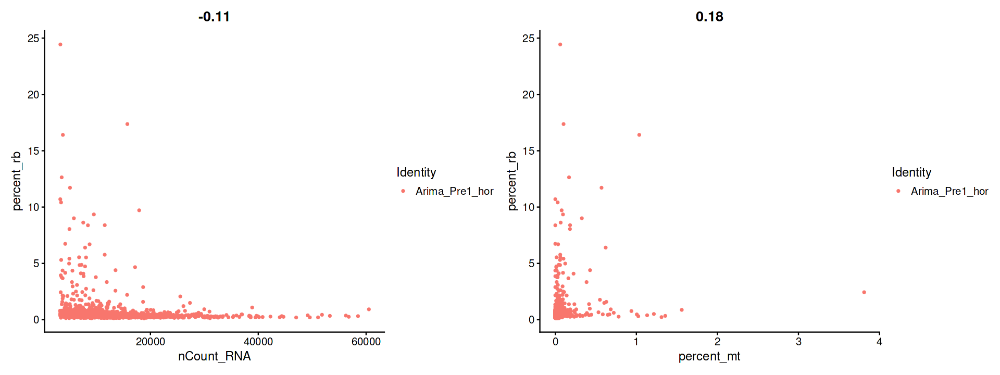

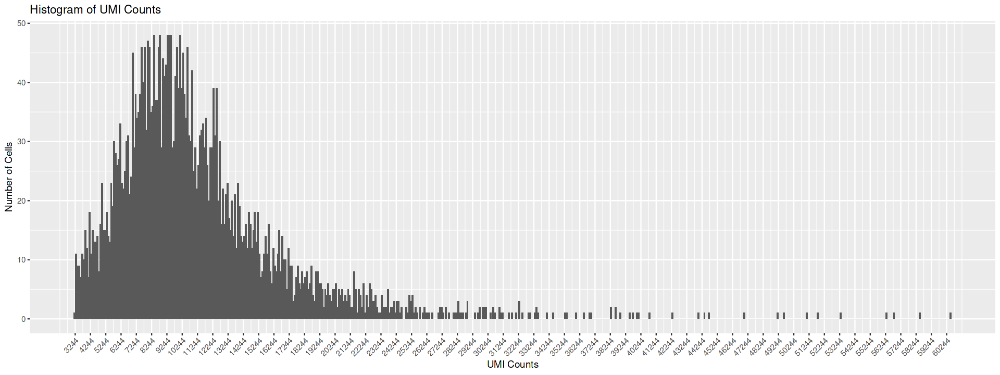

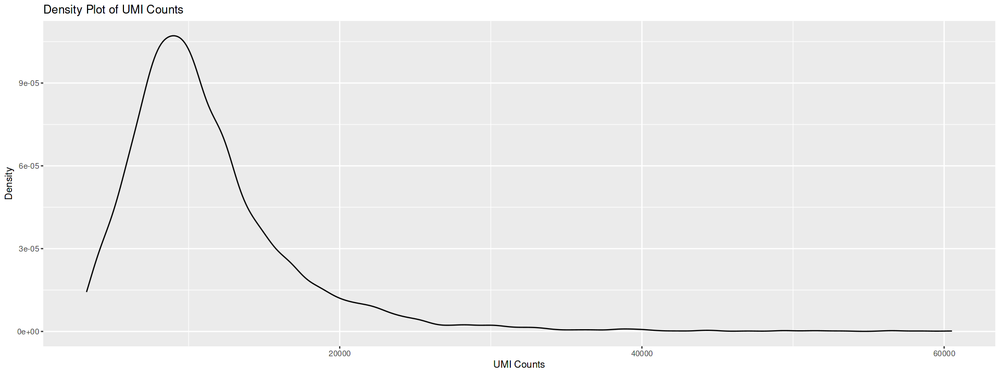

[1] "Number of genes with only zero values: 0"
[1] "Number of genes with only 1 or 0 values: 4950"


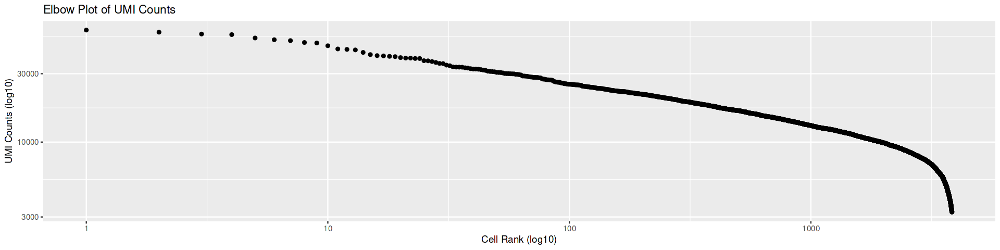

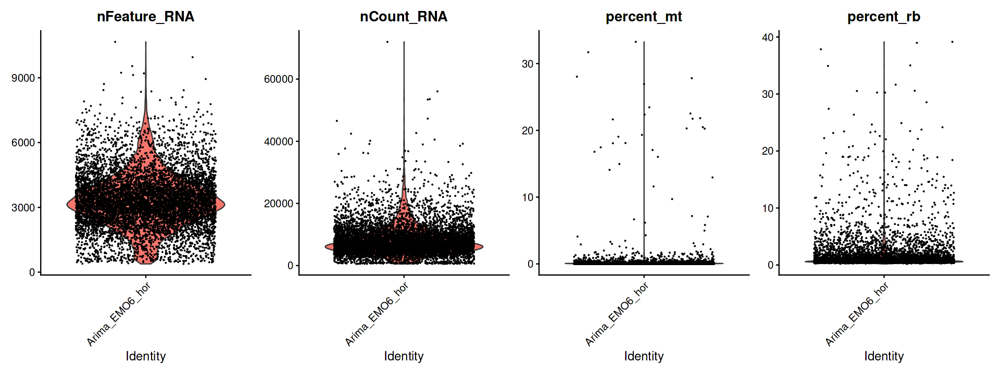

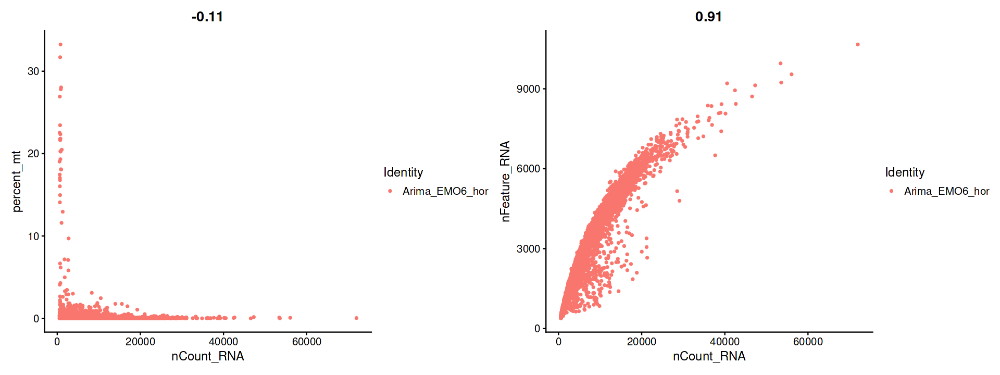

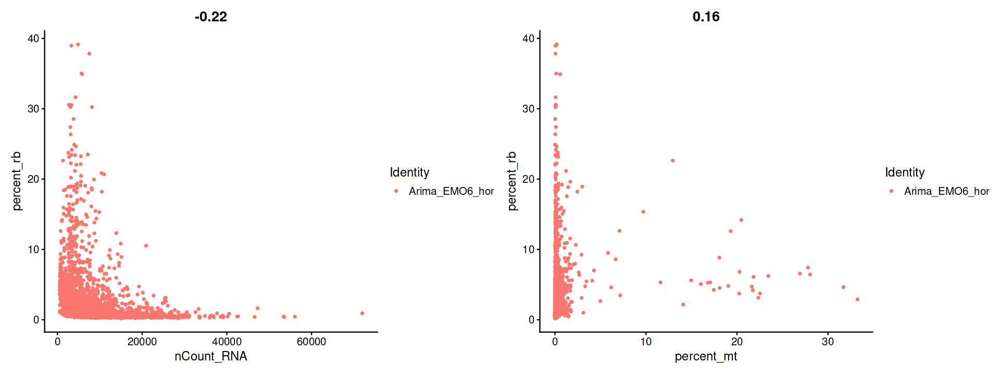

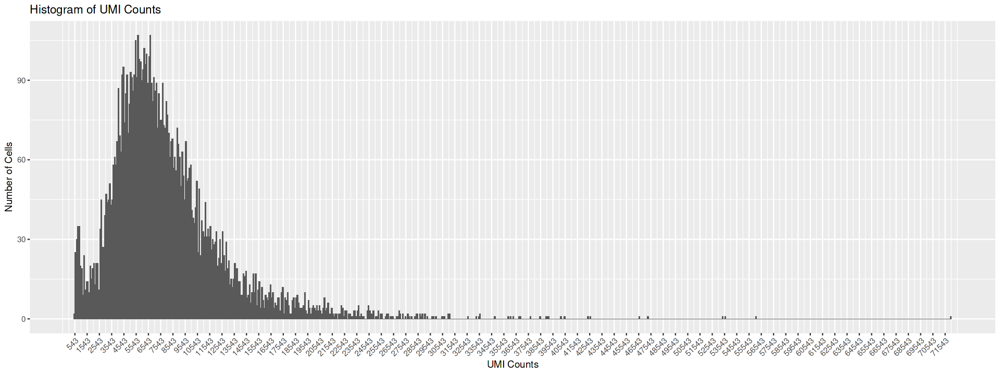

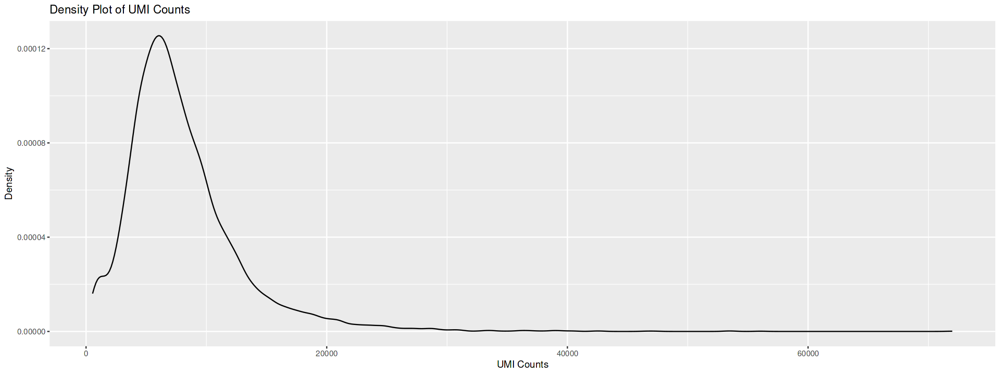

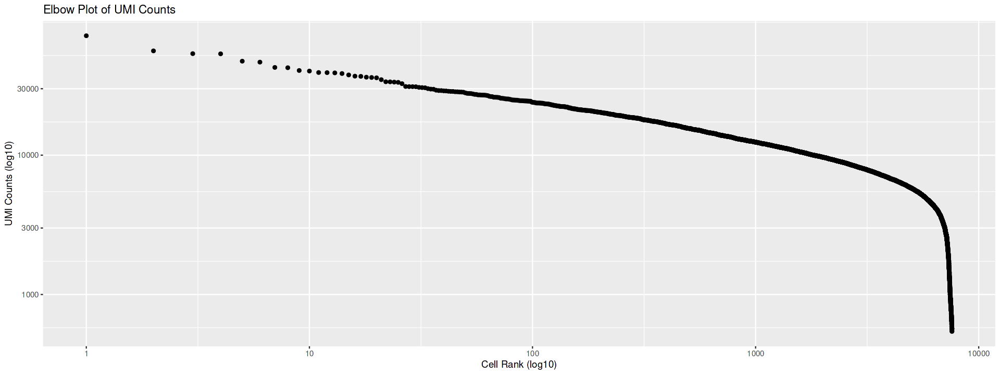

In [7]:
so.list <- lapply(so.list, function(x) do_QC(x, "results/2023-01" ,"ari_org_run1"))

An object of class Seurat 
27472 features across 7975 samples within 1 assay 
Active assay: RNA (27472 features, 0 variable features)

An object of class Seurat 
27472 features across 7288 samples within 1 assay 
Active assay: RNA (27472 features, 0 variable features)

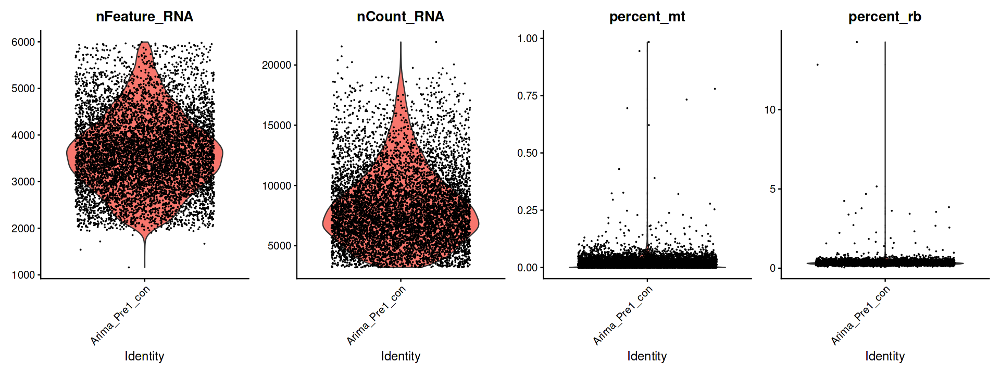

In [8]:
# Filter out features and mitochondrial content based on visual check
so.list[[1]]
temp <- subset(so.list[[1]], subset = nFeature_RNA > 1000 & nFeature_RNA < 6000 & percent_mt < 1 & nUMI >= 3200)
temp
VlnPlot(temp, features = c("nFeature_RNA", "nCount_RNA", "percent_mt", "percent_rb"), ncol = 4, pt.size = 0.01)

An object of class Seurat 
27241 features across 3838 samples within 1 assay 
Active assay: RNA (27241 features, 0 variable features)

An object of class Seurat 
27241 features across 3607 samples within 1 assay 
Active assay: RNA (27241 features, 0 variable features)

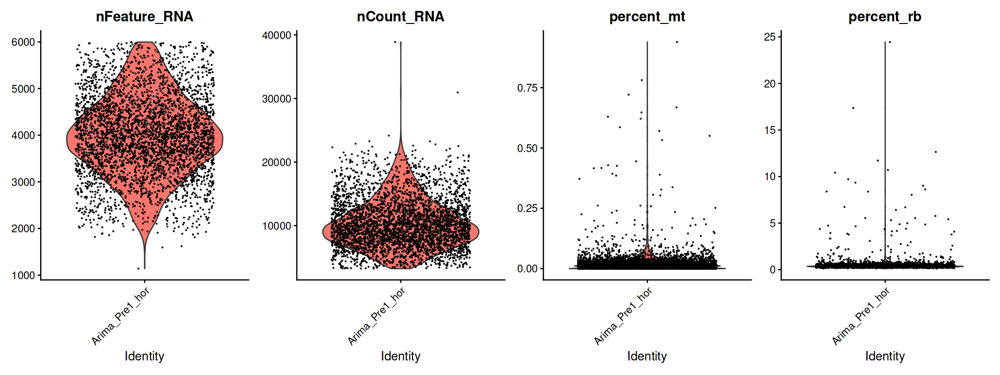

In [9]:
# Filter out features and mitochondrial content based on visual check
so.list[[2]]
temp <- subset(so.list[[2]], subset = nFeature_RNA > 1000 & nFeature_RNA < 6000 & percent_mt < 1 & nUMI >= 3200)
temp
VlnPlot(temp, features = c("nFeature_RNA", "nCount_RNA", "percent_mt", "percent_rb"), ncol = 4, pt.size = 0.01)

An object of class Seurat 
28369 features across 7588 samples within 1 assay 
Active assay: RNA (28369 features, 0 variable features)

An object of class Seurat 
28369 features across 6642 samples within 1 assay 
Active assay: RNA (28369 features, 0 variable features)

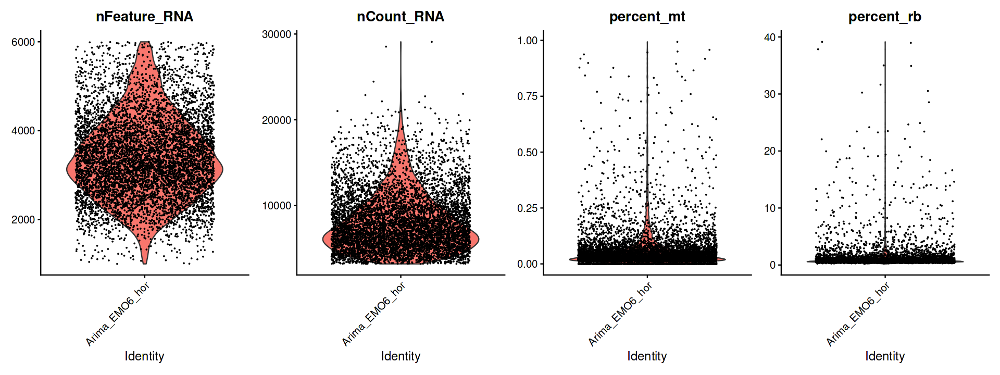

In [10]:
# Filter out features and mitochondrial content based on visual check
so.list[[3]]
temp <- subset(so.list[[3]], subset = nFeature_RNA > 1000 & nFeature_RNA < 6000 & percent_mt < 1 & nUMI >= 3200)
temp
VlnPlot(temp, features = c("nFeature_RNA", "nCount_RNA", "percent_mt", "percent_rb"), ncol = 4, pt.size = 0.01)

In [11]:
for (i in 1:length(so.list)) {
    so.list[[i]] <- subset(so.list[[i]], subset = nFeature_RNA > 1000 & nFeature_RNA < 6000 & percent_mt < 1 & nUMI >= 3200)
}

In [12]:
so.list

[[1]]
An object of class Seurat 
27472 features across 7288 samples within 1 assay 
Active assay: RNA (27472 features, 0 variable features)

[[2]]
An object of class Seurat 
27241 features across 3607 samples within 1 assay 
Active assay: RNA (27241 features, 0 variable features)

[[3]]
An object of class Seurat 
28369 features across 6642 samples within 1 assay 
Active assay: RNA (28369 features, 0 variable features)


## Filter Malat1 and ribosomal

Picking joint bandwidth of 32.5

Picking joint bandwidth of 52.8



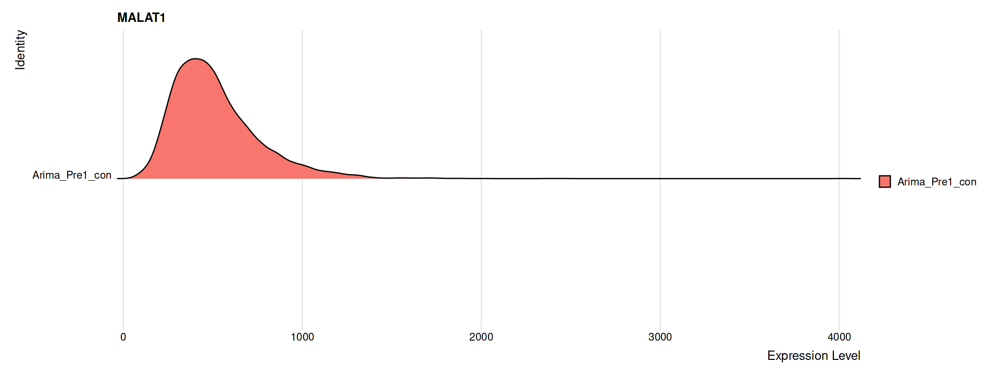

Picking joint bandwidth of 45.7



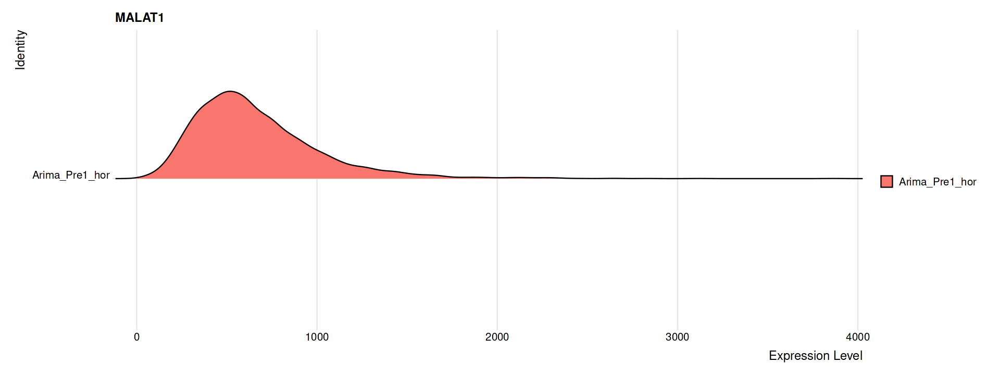

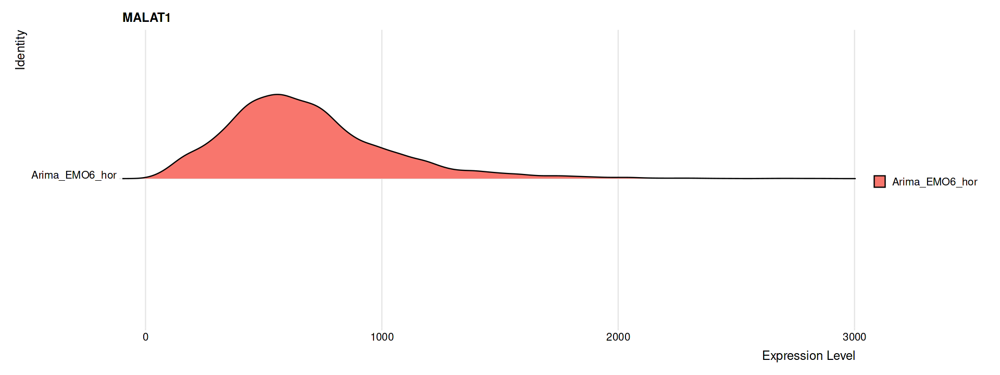

In [13]:
# Visualize the distribution of cell cycle markers across

for (i in 1:length(so.list)) {
    print(RidgePlot(so.list[[i]], features = c("MALAT1"), ncol = 1))
}

In [14]:
for (i in 1:length(so.list)) {
    so.list[[i]] <- so.list[[i]][!grepl("MALAT1", rownames(so.list[[i]])), ]
    # Filter Ribossomal gene (optional if that is a problem on your data) data.filt
    so.list[[i]] <- so.list[[i]][!grepl("^RP[SL]", rownames(so.list[[i]])), ]
}

[1] "Number of genes with only zero values: 0"
[1] "Number of genes with only 1 or 0 values: 5713"


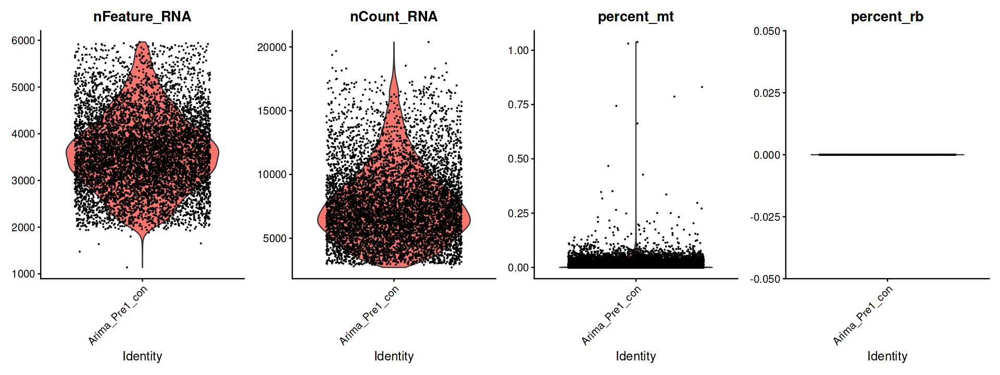

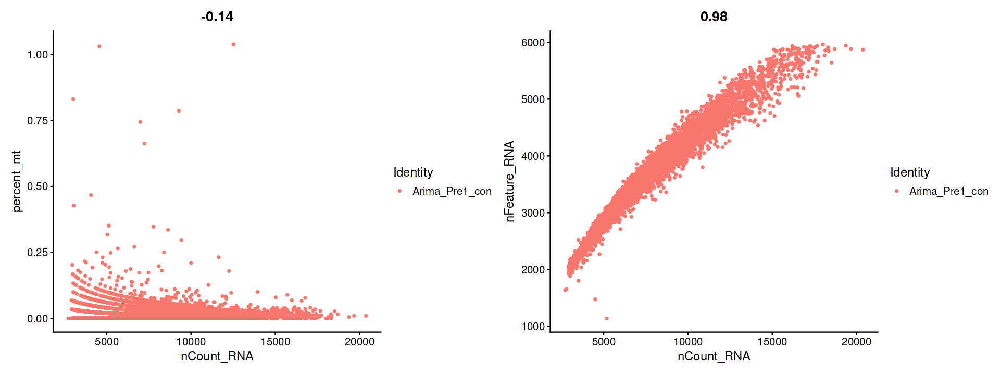

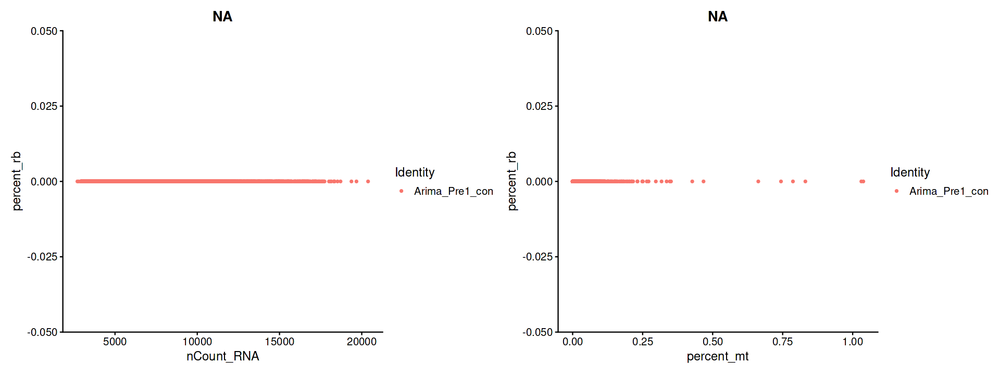

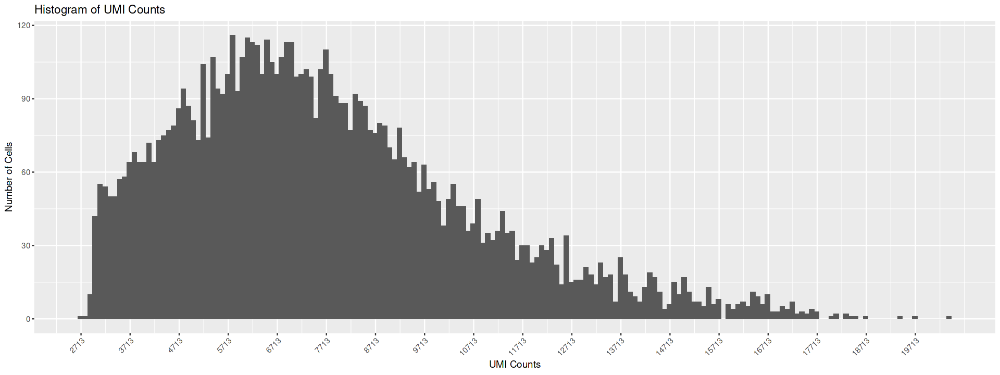

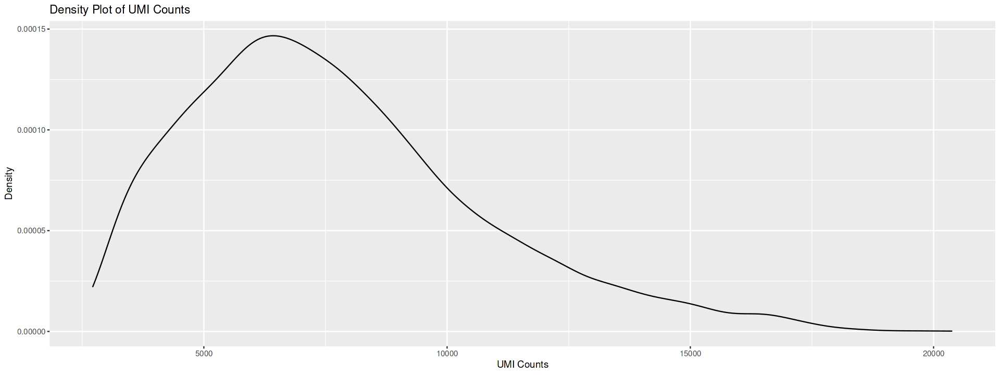

[1] "Number of genes with only zero values: 1"
[1] "Number of genes with only 1 or 0 values: 5082"


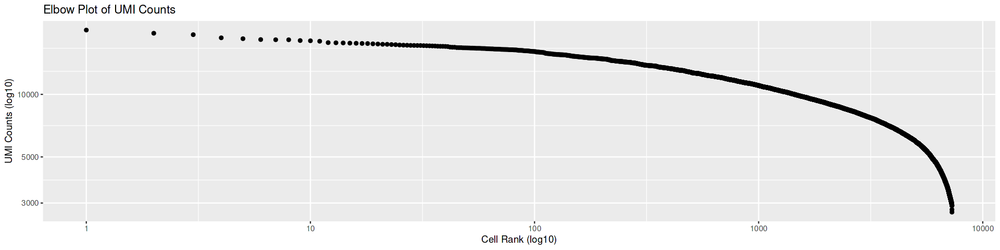

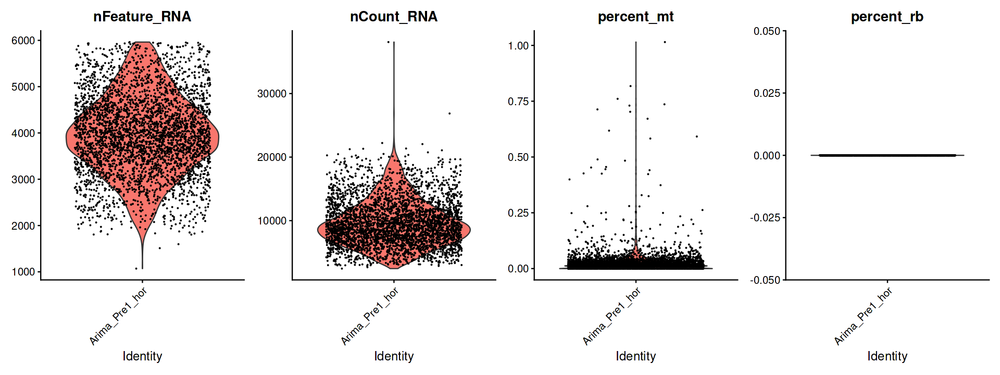

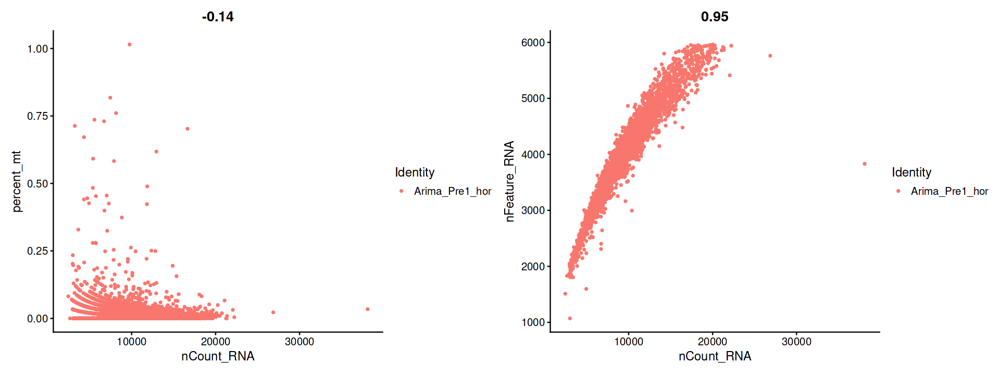

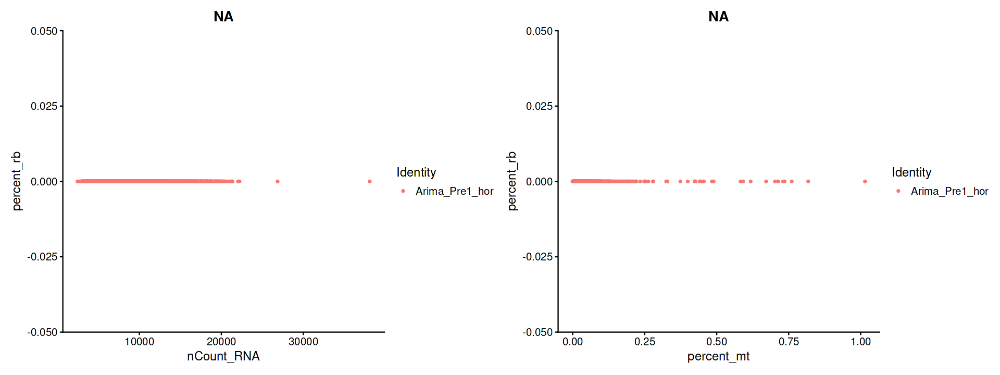

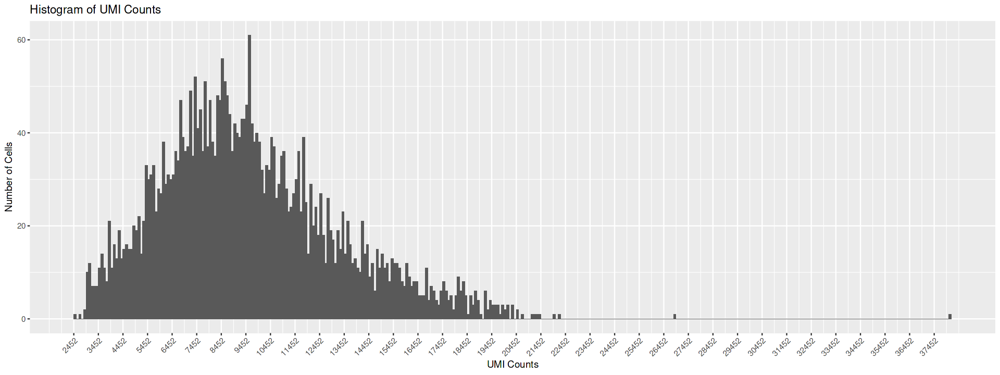

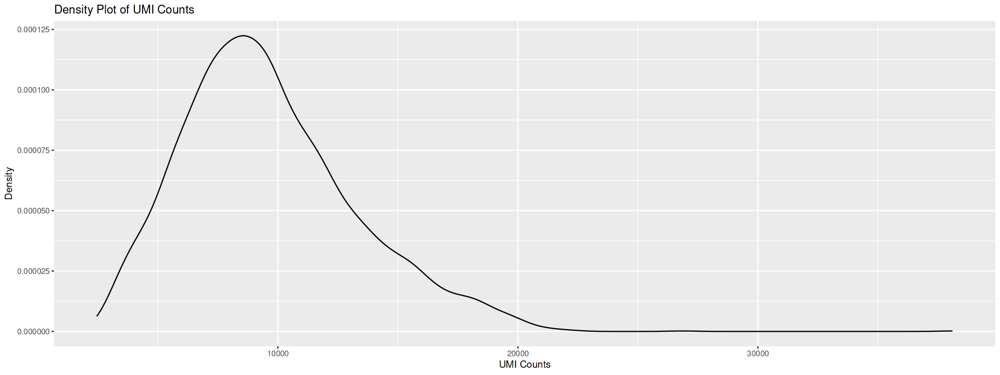

[1] "Number of genes with only zero values: 6"
[1] "Number of genes with only 1 or 0 values: 5355"


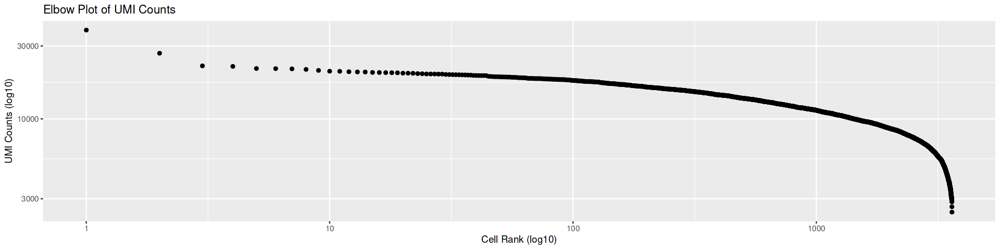

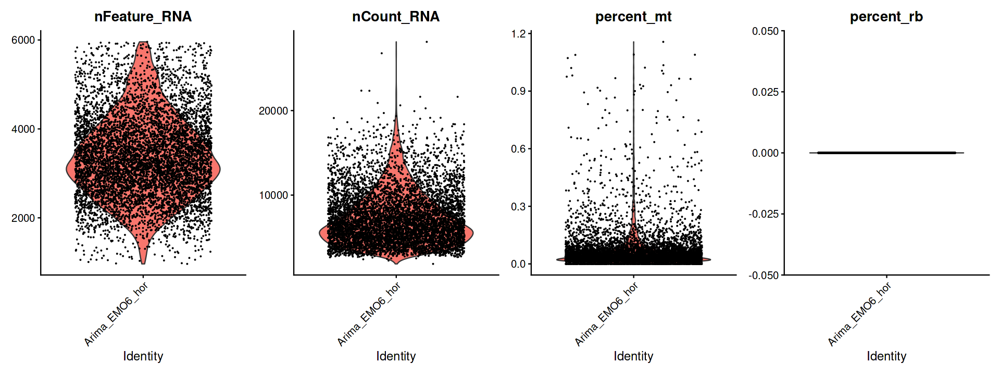

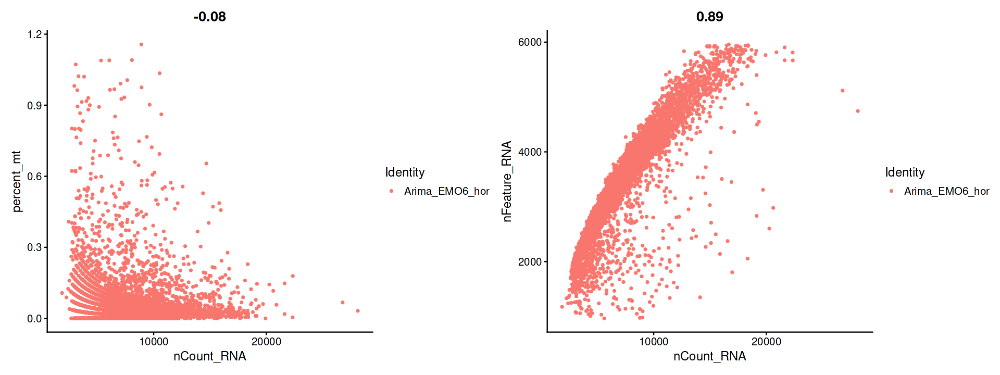

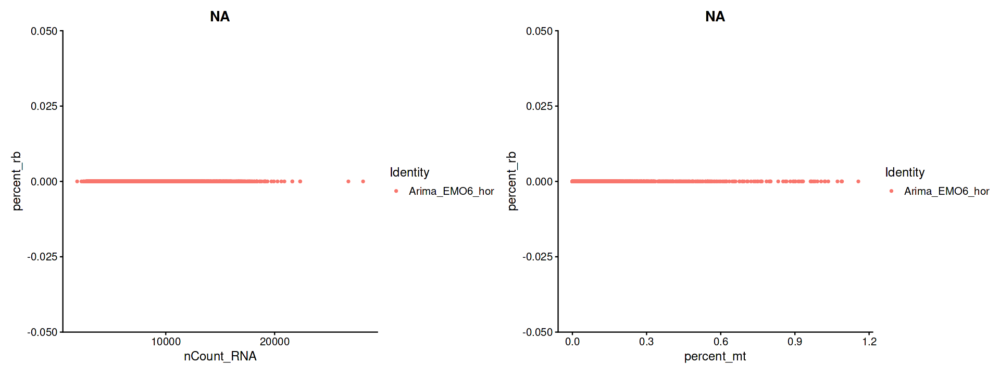

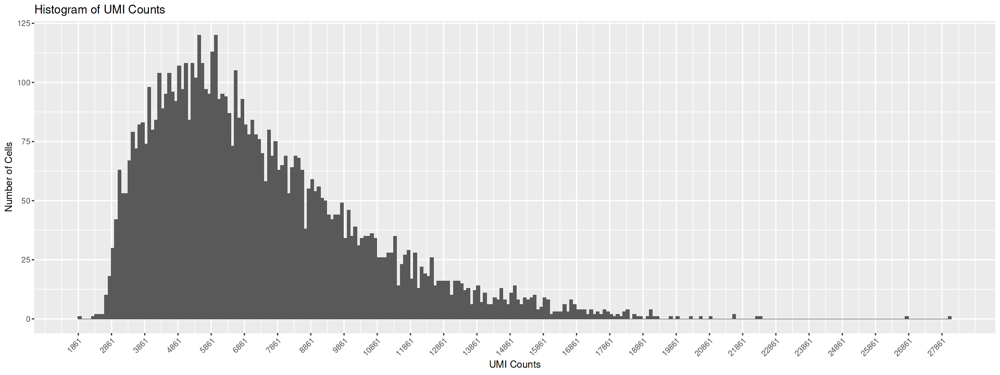

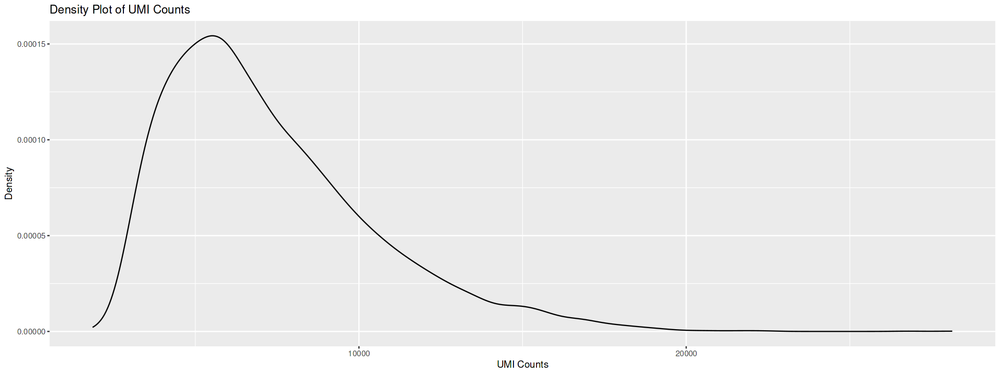

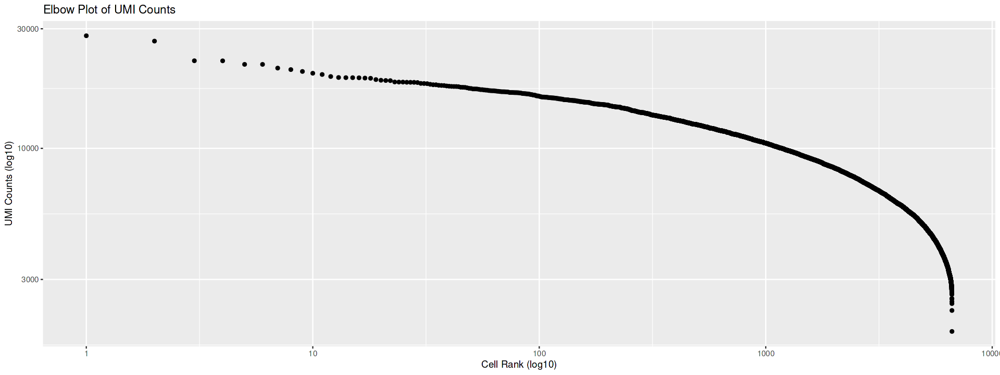

In [15]:
so.list <- lapply(so.list, function(x) do_QC(x, "results/2023-01" ,"ari_org_run2"))

In [16]:
so.list

[[1]]
An object of class Seurat 
27371 features across 7288 samples within 1 assay 
Active assay: RNA (27371 features, 0 variable features)

[[2]]
An object of class Seurat 
27139 features across 3607 samples within 1 assay 
Active assay: RNA (27139 features, 0 variable features)

[[3]]
An object of class Seurat 
28267 features across 6642 samples within 1 assay 
Active assay: RNA (28267 features, 0 variable features)


## Cell-cycle scoring and regression

In [17]:
# A list of cell cycle markers, from Tirosh et al, 2015, is loaded with Seurat.  We can
# segregate this list into markers of G2/M phase and markers of S phase
s.genes <- cc.genes$s.genes
g2m.genes <- cc.genes$g2m.genes

In [18]:
for (i in 1:length(so.list)) {
    so.list[[i]] <- CellCycleScoring(so.list[[i]], s.features = s.genes, g2m.features = g2m.genes, set.ident = TRUE)
}

In [19]:
head(so.list[[1]]@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent_mt,percent_rb,nUMI,S.Score,G2M.Score,Phase,old.ident
,<fct>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<fct>
AAACCCAAGAACCCGA-1,Arima_Pre1_con,8096,3786,0.04940711,0,8096,-0.01967306,0.002771246,G2M,Arima_Pre1_con
AAACCCAAGACATCAA-1,Arima_Pre1_con,6645,3199,0.01504891,0,6645,-0.08207534,-0.144767290,G1,Arima_Pre1_con
AAACCCAAGCGACCCT-1,Arima_Pre1_con,8680,4231,0.00000000,0,8680,-0.24895522,-0.045133057,G1,Arima_Pre1_con
AAACCCACAACGCCCA-1,Arima_Pre1_con,3434,2203,0.02912056,0,3434,-0.08238806,-0.034318665,G1,Arima_Pre1_con
AAACCCACATACCAGT-1,Arima_Pre1_con,7236,3560,0.00000000,0,7236,-0.13692964,0.007138058,G2M,Arima_Pre1_con
AAACCCACATGGTACT-1,Arima_Pre1_con,6897,3404,0.05799623,0,6897,-0.06065387,0.014416079,G2M,Arima_Pre1_con


In [20]:
# Running SCTransform v2 
# https://satijalab.org/seurat/articles/sctransform_v2_vignette.html

for (i in 1:length(so.list)) {
    so.list[[i]] <- SCTransform(so.list[[i]], vst.flavor = "v2", verbose = FALSE,
                                do.scale=FALSE, do.center=FALSE)
}

Picking joint bandwidth of 2.13e-06

Picking joint bandwidth of 2.35e-06

Picking joint bandwidth of 2.54e-06

Picking joint bandwidth of 2.27e-06

Picking joint bandwidth of 2.3e-06

Picking joint bandwidth of 2.32e-06

Picking joint bandwidth of 2.41e-06

Picking joint bandwidth of 2.28e-06



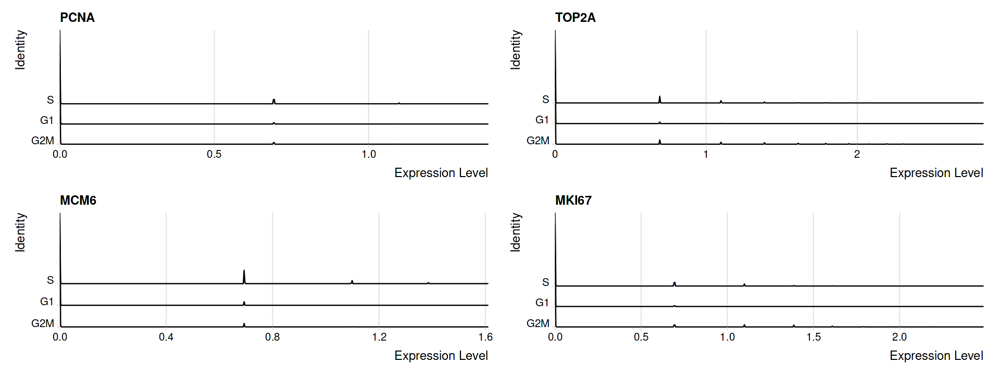

Picking joint bandwidth of 2.22e-06

Picking joint bandwidth of 0.0374

Picking joint bandwidth of 2.38e-06

Picking joint bandwidth of 2.62e-06



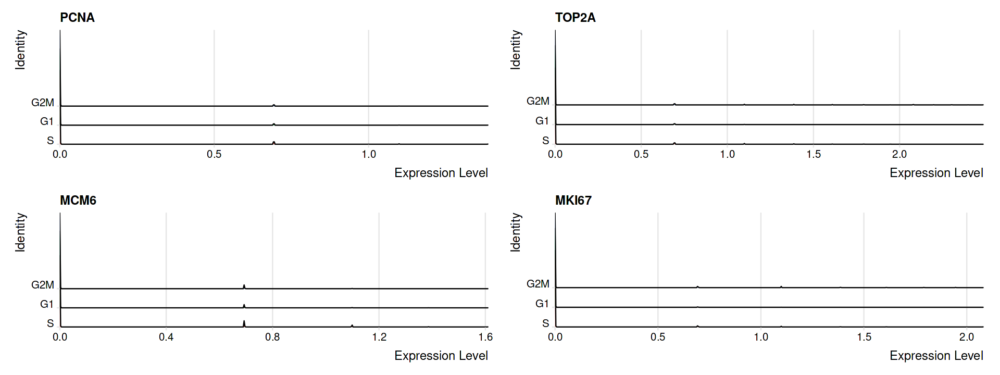

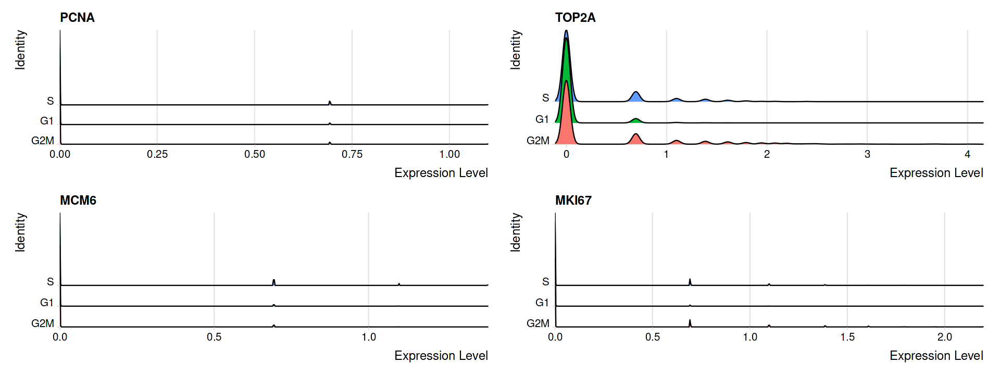

In [21]:
# Visualize the distribution of cell cycle markers across

for (i in 1:length(so.list)) {
    print(RidgePlot(so.list[[i]], features = c("PCNA", "TOP2A", "MCM6", "MKI67"), ncol = 2))
}

Warning message in irlba(A = t(x = object), nv = npcs, ...):
“You're computing too large a percentage of total singular values, use a standard svd instead.”
Warning message in irlba(A = t(x = object), nv = npcs, ...):
“did not converge--results might be invalid!; try increasing work or maxit”
PC_ 1 
Positive:  CDCA7, RRM1, POLA1, CDC6, CDC45, WDR76, UHRF1, GAS2L3, EXO1, HMGB2 
	   HMMR, TTK, CDCA8, TACC3, SMC4, BUB1, BLM, HELLS, KIF20B, KIF11 
Negative:  TOP2A, CENPF, CENPE, BRIP1, RRM2, MKI67, NUSAP1, ANLN, GTSE1, CDCA2 
	   DLGAP5, TPX2, KIF23, NDC80, CLSPN, ATAD2, KIF2C, DTL, HJURP, CDC25C 
PC_ 2 
Positive:  CENPE, CENPF, TOP2A, GTSE1, HMMR, GAS2L3, DLGAP5, TPX2, CDC25C, MKI67 
	   KIF23, CDCA2, TTK, KIF2C, HJURP, BUB1, NUSAP1, KIF20B, NDC80, CDCA8 
Negative:  DTL, BRIP1, HELLS, CLSPN, ATAD2, CDC45, WDR76, UHRF1, POLA1, CDC6 
	   BLM, EXO1, CDCA7, RRM1, RRM2, SMC4, TACC3, ANLN, KIF11, HMGB2 
PC_ 3 
Positive:  DTL, CENPF, UHRF1, CENPE, CDCA7, CDC45, CDC6, HELLS, GAS2L3, HMMR 
	   WDR

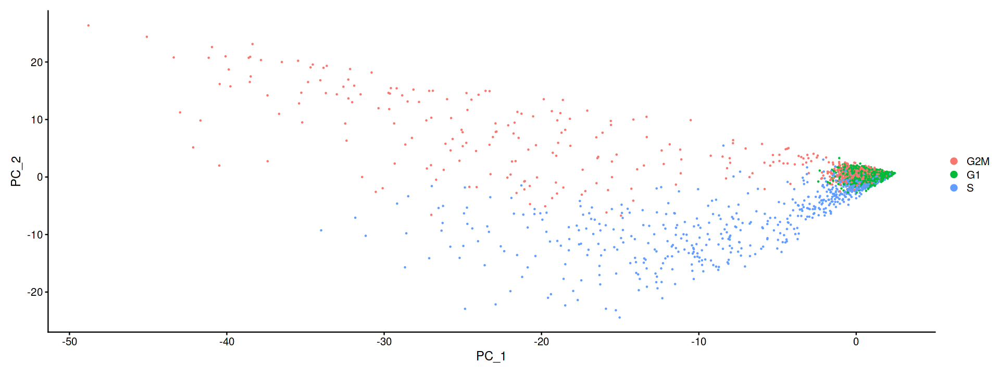

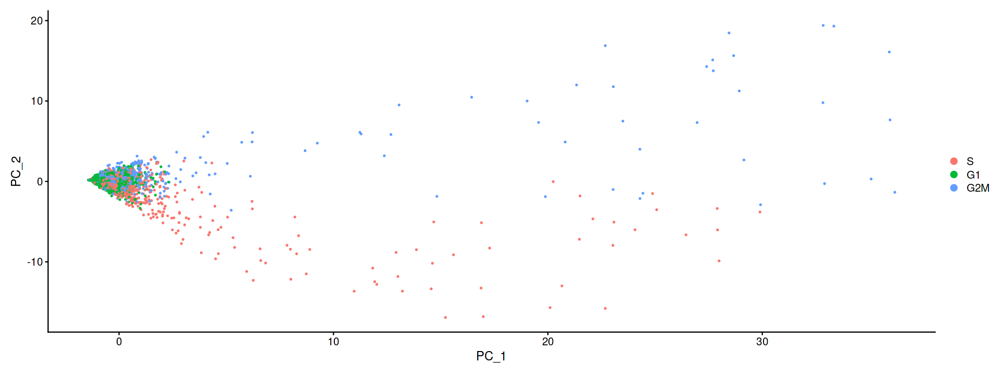

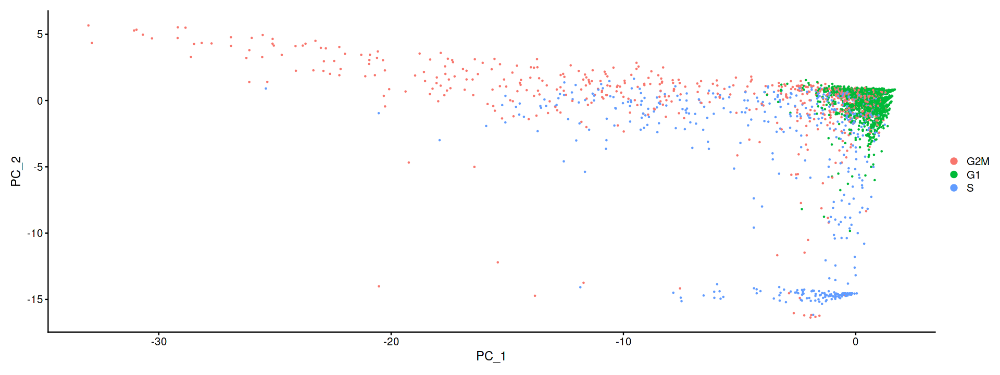

In [22]:
# Running a PCA on cell cycle genes reveals, unsurprisingly, that cells separate entirely by
# phase
for (i in 1:length(so.list)) {
    so.list[[i]] <- RunPCA(so.list[[i]], features = c(s.genes, g2m.genes))
    print(DimPlot(so.list[[i]]))
}

# Data integration

In [23]:
# Explained here https://satijalab.org/seurat/articles/cell_cycle_vignette.html
# In short, we will regreee out the difference between the G2M and S phases scores.
for (i in 1:length(so.list)) {
    so.list[[i]]$CC.Difference <- so.list[[i]]$S.Score - so.list[[i]]$G2M.Score

    # SCTransformation
    DefaultAssay(object = so.list[[i]]) <- "RNA"
    so.list[[i]] <- SCTransform(so.list[[i]], vst.flavor = "v2", 
                                vars.to.regress = c("percent_mt", "CC.Difference", "percent_rb"), 
                                do.scale=TRUE, do.center=TRUE)
}

vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 24529

Total overdispersed genes: 21197

Excluding 3332 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 25624 by 7288

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 5000 cells



  |======================================================================| 100%


Setting estimate of  106 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 1289

Total # of Step1 poisson genes (theta=Inf; variance < mean): 131

Total # of poisson genes (theta=Inf; variance < mean): 4378

Calling offset model for all 4378 poisson genes

Found 119 outliers - those will be ignored in fitting/regularization step


Ignoring theta inf genes

Replacing fit params for 4378 poisson genes by theta=Inf

Setting min_variance based on median UMI:  0.04

Second step: Get residuals using fitted parameters for 25624 genes



  |======================================================================| 100%


Computing corrected count matrix for 25624 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 34.39793 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out percent_mt, CC.Difference, percent_rb

Centering and scaling data matrix

Set default assay to SCT

vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 25148

Total overdispersed genes: 21693

Excluding 3455 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 25148 by 3607

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 3607 cells



  |======================================================================| 100%


Setting estimate of  0 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 0

Total # of Step1 poisson genes (theta=Inf; variance < mean): 0

Total # of poisson genes (theta=Inf; variance < mean): 3455

Calling offset model for all 3455 poisson genes

Found 9 outliers - those will be ignored in fitting/regularization step


Ignoring theta inf genes

Replacing fit params for 3455 poisson genes by theta=Inf

Setting min_variance based on median UMI:  0.04

Second step: Get residuals using fitted parameters for 25148 genes



  |======================================================================| 100%


Computing corrected count matrix for 25148 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 19.59793 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out percent_mt, CC.Difference, percent_rb

Centering and scaling data matrix

Set default assay to SCT

vst.flavor='v2' set, setting model to use fixed slope and exclude poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Total Step 1 genes: 25585

Total overdispersed genes: 22399

Excluding 3186 genes from Step 1 because they are not overdispersed.

Variance stabilizing transformation of count matrix of size 26481 by 6642

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 5000 cells



  |======================================================================| 100%


Setting estimate of  64 genes to inf as theta_mm/theta_mle < 1e-3

# of step1 poisson genes (variance < mean): 0

# of low mean genes (mean < 0.001): 962

Total # of Step1 poisson genes (theta=Inf; variance < mean): 76

Total # of poisson genes (theta=Inf; variance < mean): 3944

Calling offset model for all 3944 poisson genes

Found 93 outliers - those will be ignored in fitting/regularization step


Ignoring theta inf genes

Replacing fit params for 3944 poisson genes by theta=Inf

Setting min_variance based on median UMI:  0.04

Second step: Get residuals using fitted parameters for 26481 genes



  |======================================================================| 100%


Computing corrected count matrix for 26481 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 31.12105 secs

Determine variable features

Place corrected count matrix in counts slot

Regressing out percent_mt, CC.Difference, percent_rb

Centering and scaling data matrix

Set default assay to SCT



In [24]:
features <- SelectIntegrationFeatures(object.list = so.list, nfeatures = 3000)

In [25]:
so.list <- PrepSCTIntegration(object.list = so.list, anchor.features = features)

In [26]:
so.anchors <- FindIntegrationAnchors(object.list = so.list, normalization.method = "SCT",
    anchor.features = features)

Finding all pairwise anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 11900 anchors

Filtering anchors

	Retained 8710 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 17073 anchors

Filtering anchors

	Retained 8596 anchors

Running CCA

Merging objects

Finding neighborhoods

Finding anchors

	Found 10968 anchors

Filtering anchors

	Retained 6587 anchors



In [27]:
all_features <- lapply(so.list, row.names) %>% Reduce(intersect, .)

In [28]:
# In order to keep all other genes and not just the 3000 anchor genes, it is 
# necessary to include the feature to keep using "features.to.integrate"
# https://github.com/satijalab/seurat/issues/2590
so.combined.sct <- IntegrateData(anchorset = so.anchors, normalization.method = "SCT",
                                features.to.integrate = all_features)

sct.model: model1

Setting min_variance based on median UMI:  0.04

Calculating residuals of type pearson for 21081 genes



  |======================================================================| 100%


sct.model: model1

Setting min_variance based on median UMI:  0.04

Calculating residuals of type pearson for 21081 genes



  |======================================================================| 100%


sct.model: model1

Setting min_variance based on median UMI:  0.04

Calculating residuals of type pearson for 21081 genes



  |======================================================================| 100%


Merging dataset 2 into 1

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Merging dataset 3 into 1 2

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data



In [29]:
nrow(so.combined.sct[["integrated"]]@scale.data)
length(all_features)

[1] 24081

[1] 24081

In [30]:
so.combined.sct <- RunPCA(so.combined.sct, verbose = FALSE)
so.combined.sct <- RunUMAP(so.combined.sct, reduction = "pca", dims = 1:30)

15:41:08 UMAP embedding parameters a = 0.9922 b = 1.112

15:41:08 Read 17537 rows and found 30 numeric columns

15:41:08 Using Annoy for neighbor search, n_neighbors = 30

15:41:08 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

15:41:10 Writing NN index file to temp file /tmp/RtmptjagL8/file3f1eae64673807

15:41:10 Searching Annoy index using 1 thread, search_k = 3000

15:41:16 Annoy recall = 100%

15:41:19 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

15:41:20 Initializing from normalized Laplacian + noise (using irlba)

15:41:21 Commencing optimization for 200 epochs, with 736172 positive edges

15:41:28 Optimization finished



In [31]:
so.combined.sct <- RunTSNE(so.combined.sct, verbose = FALSE)
so.combined.sct <- FindNeighbors(so.combined.sct, reduction = "pca", dims = 1:30)
so.combined.sct <- FindClusters(so.combined.sct, resolution = c(0.3, 0.5, 0.6, 0.7, 0.8, 0.9, 1))

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 17537
Number of edges: 608988

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8920
Number of communities: 9
Elapsed time: 3 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 17537
Number of edges: 608988

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8639
Number of communities: 10
Elapsed time: 3 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 17537
Number of edges: 608988

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8517
Number of communities: 11
Elapsed time: 3 seconds
Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 17537
Number of edges: 608988

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8407
Number of communities: 15
Elapsed time: 2 seconds
Modularity Op

In [32]:
so.combined.sct

An object of class Seurat 
81018 features across 17537 samples within 3 assays 
Active assay: integrated (24081 features, 3000 variable features)
 2 other assays present: RNA, SCT
 3 dimensional reductions calculated: pca, umap, tsne

In [33]:
#colnames(x = pbmc)
#Cells(object = so.combined.sct)
#rownames(x = pbmc)
#ncol(x = pbmc)
nrow(x = so.combined.sct)

[1] 24081

In [34]:
# Resolution that best fit expected number of cells and clusters observed
Idents(object = so.combined.sct) <- so.combined.sct$integrated_snn_res.0.7
so.combined.sct$clusters <- so.combined.sct$integrated_snn_res.0.7
so.combined.sct$sample <- so.combined.sct$orig.ident

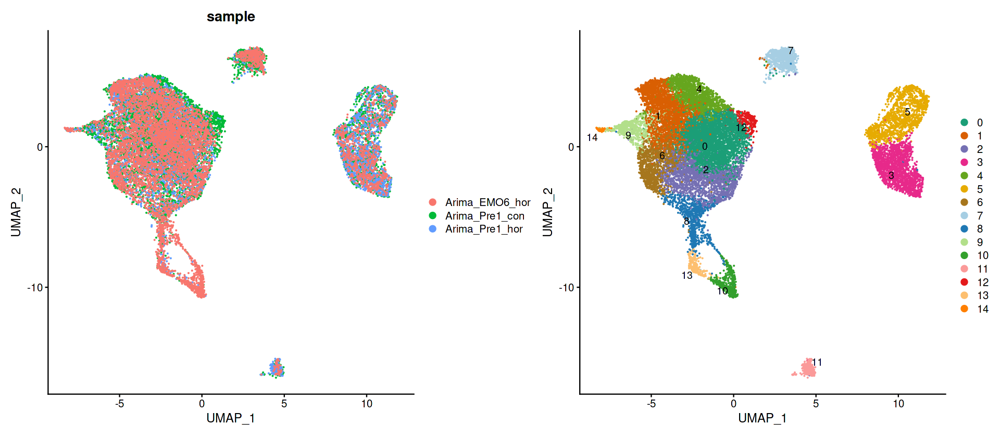

In [35]:
# Visualization
p1 <- DimPlot(so.combined.sct, reduction = "umap", group.by = "sample")
p2 <- DimPlot(so.combined.sct, reduction = "umap", label = TRUE, repel = TRUE, cols = color_palette)

plot.width = 16
plot.height = 7
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
p1 + p2
ggsave(file="results/2023-04-28/ari_org_umap_1.pdf", width = plot.width, height = plot.height)

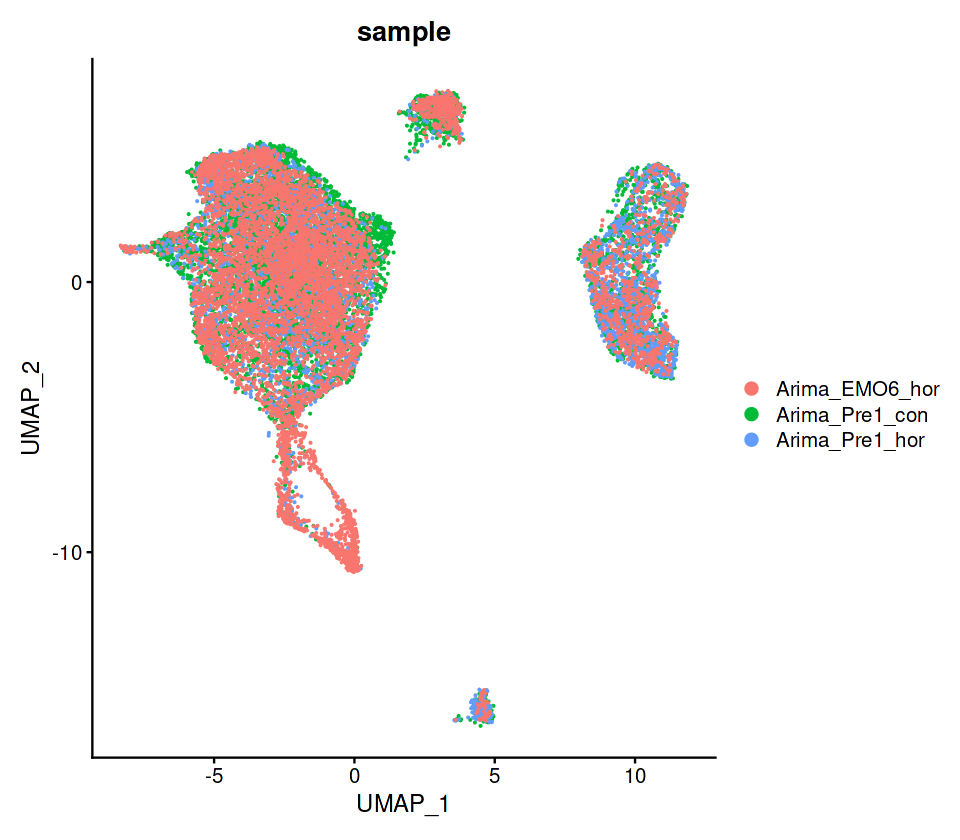

In [36]:
plot.width = 8
plot.height = 7
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
DimPlot(so.combined.sct, reduction = "umap", group.by = "sample")

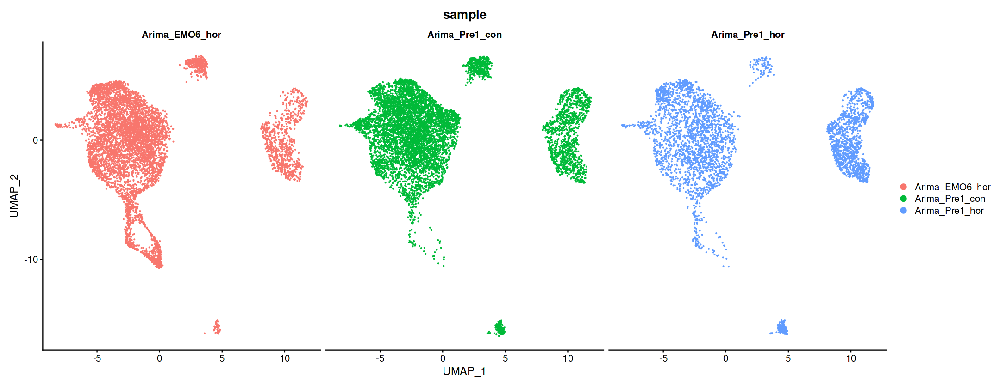

In [37]:
plot.width = 18
plot.height = 7
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
DimPlot(so.combined.sct, reduction = "umap", group.by = "sample", split.by = "sample")
ggsave(file="results/2023-01/ari_org_umap_split_by_sample.pdf", width = plot.width, height = plot.height)

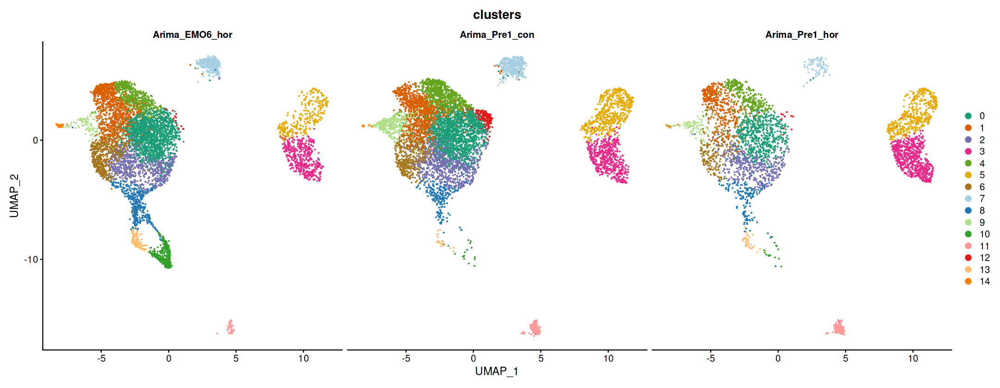

In [38]:
plot.width = 18
plot.height = 7
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
DimPlot(so.combined.sct, reduction = "umap", group.by = "clusters", split.by = "sample", cols = color_palette)
ggsave(file="results/2023-04-28/ari_org_umap_split_by_sample_clusters.pdf", width = plot.width, height = plot.height)

In [39]:
# Reference: 
markers = c("LGR5",
            "EPCAM", "SOX9", "MMP7",             #SOX9
            "LGR5", "PTGS1",                     #Lumenal
            "SCGB2A2", "SLC18A2", "PAEP",        #Glandular
            "FOXJ1", "PIFO",                     #Ciliated
            "ACTA2", "MYH11", "LEFTY2", "ACTG2", #uSMC
            "RGS5", "NTRK2", "FHL5",             #PV MYH11
            "GUCY1A2", "STEAP4", "IGF1", "PCOLCE", #PV STEAP4
            "C7", "OGN",                         #Fibroblast C7
            "MMP11", "SFRP1",                    #eS
            "DKK1", "FOXO1",                     #dS
            "CD34", "SEMA3G", "GJA5",            #Endothelial artery
            "ACKR1", "PLVAP",                    #Endothelial vein
            "PTPRC", "CD3G", "NCAM1",             #Lymphoid
            "CD14", "CSF1R")                     #Myeloid

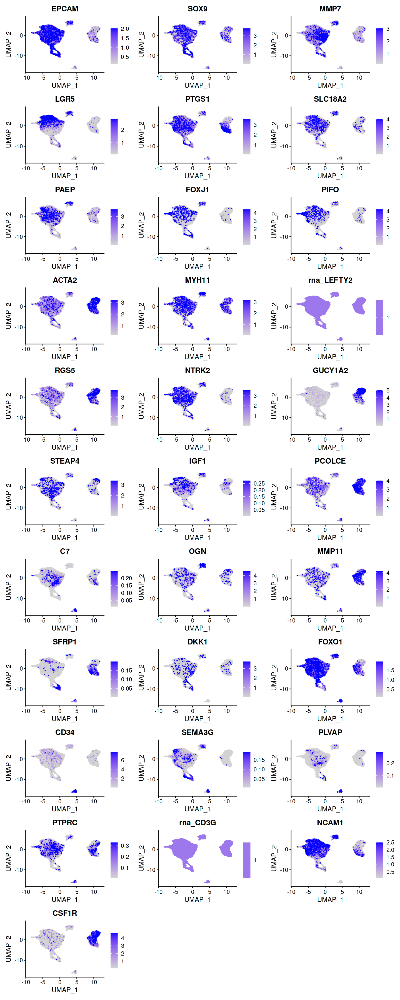

In [40]:
plot.width = 12
plot.height = 30
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
FeaturePlot(so.combined.sct, features = markers, order = TRUE, min.cutoff = 'q10', max.cutoff = 'q90', ncol = 3)
ggsave(file="results/2023-01/ari_org_known_markers_from_ga.pdf", width = plot.width, height = plot.height)

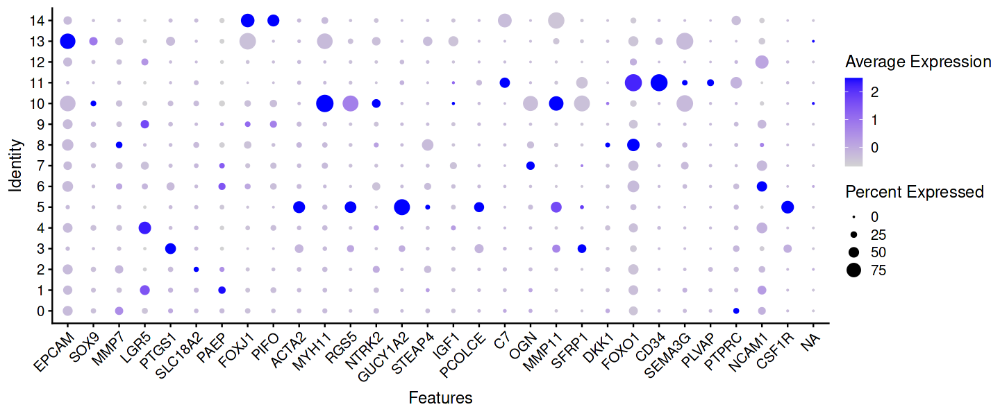

In [41]:
plot.width = 12
plot.height = 5
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
DotPlot(so.combined.sct, features = markers) + RotatedAxis()
ggsave(file="results/2023-04-28/ari_org_dotplot_by_clusters.pdf", width = plot.width, height = plot.height)

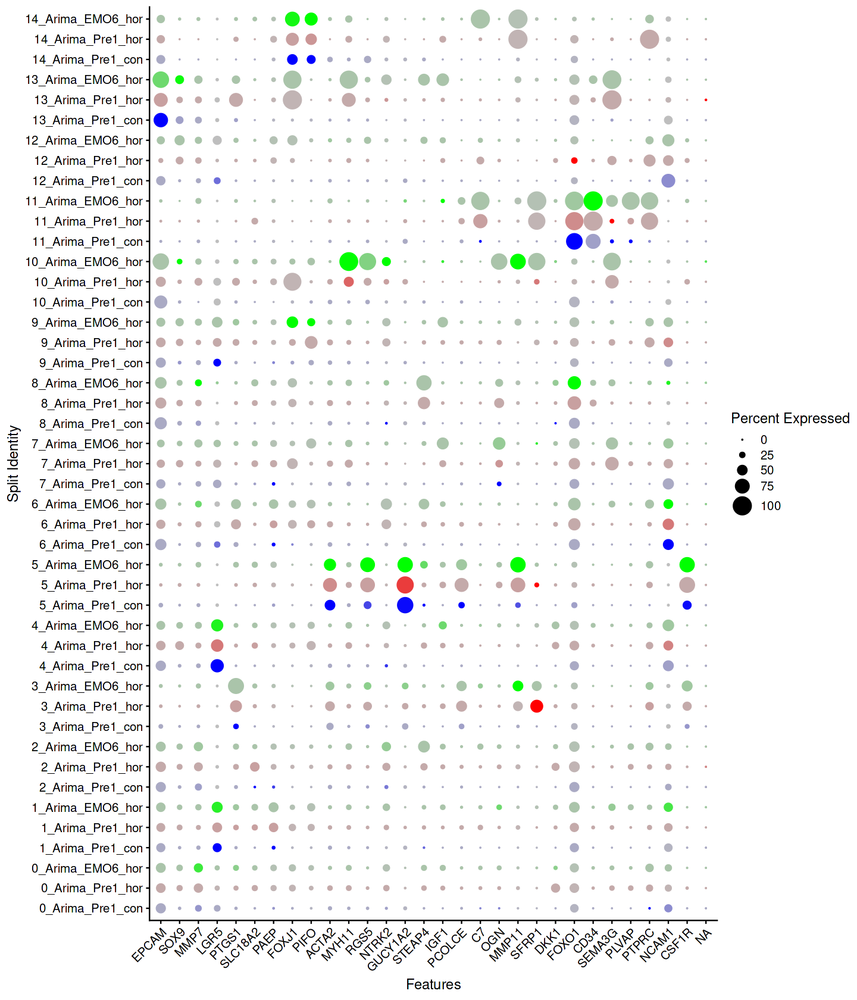

In [42]:
# Dot plots - the size of the dot corresponds to the percentage of cells expressing the
# feature in each cluster. The color represents the average expression level
plot.width = 12
plot.height = 14
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
DotPlot(so.combined.sct, features = markers, cols = c("blue", "red", "green"), dot.scale = 8, split.by = "sample") +
    RotatedAxis()
ggsave(file="results/2023-04-28/ari_org_dotplot_by_sample.pdf", width = plot.width, height = plot.height)

The default behaviour of split.by has changed.
Separate violin plots are now plotted side-by-side.
To restore the old behaviour of a single split violin,
set split.plot = TRUE.
      
This message will be shown once per session.



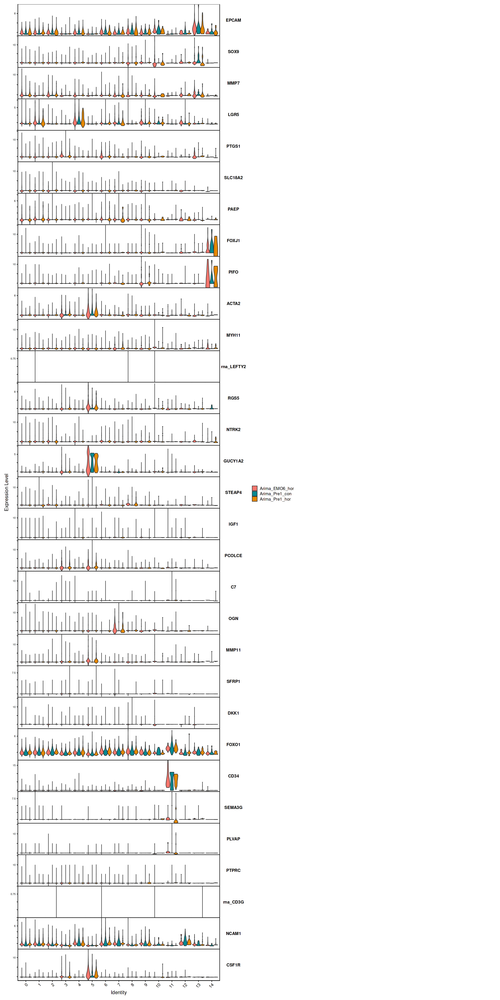

In [43]:
# Differential genes between conditions based on cluster 2

plots <- VlnPlot(so.combined.sct, features = markers, split.by = "sample", group.by = "clusters",
    pt.size = 0, combine = FALSE, split.plot = FALSE, stack=TRUE, flip = TRUE) 

plot.width = 20
plot.height = 40
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
wrap_plots(plots = plots, ncol = 2)
ggsave(file="results/2023-04-28/ari_org_violin_known_markers_from_ga.pdf", width = plot.width, height = plot.height)

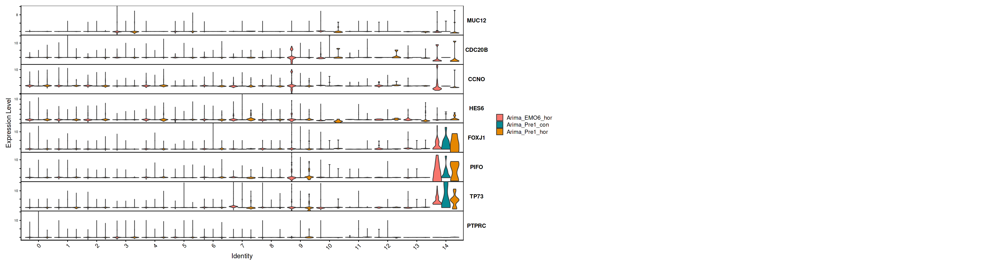

In [44]:
# Manual annotation based on markers from Garcia-Alonso

#cluster 
markers_c1 = c("MUC12", "CDC20B", "CCNO", "HES6", "FOXJ1", "PIFO", "TP73", "PTPRC") 

plots <- VlnPlot(so.combined.sct, features = markers_c1, split.by = "sample", group.by = "clusters",
    pt.size = 0, combine = FALSE, split.plot = FALSE, stack=TRUE, flip = TRUE) 

plot.width = 30
plot.height = 8
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
wrap_plots(plots = plots, ncol = 2)

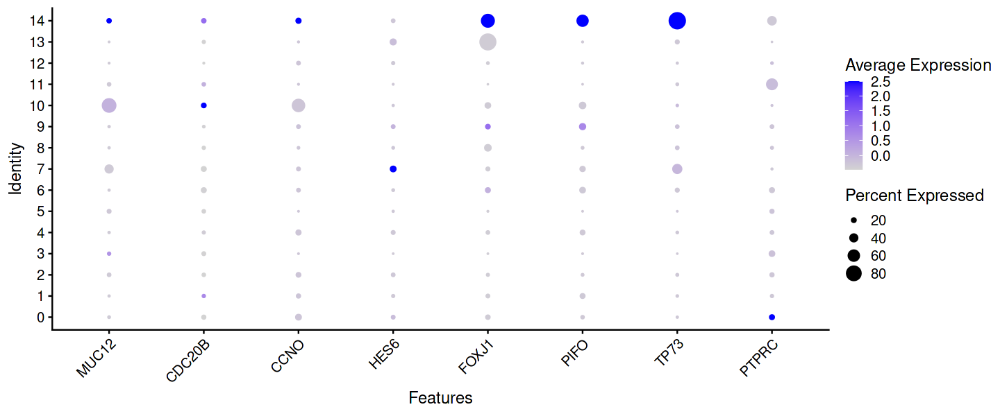

In [45]:
plot.width = 12
plot.height = 5
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
DotPlot(so.combined.sct, features = markers_c1) + RotatedAxis()

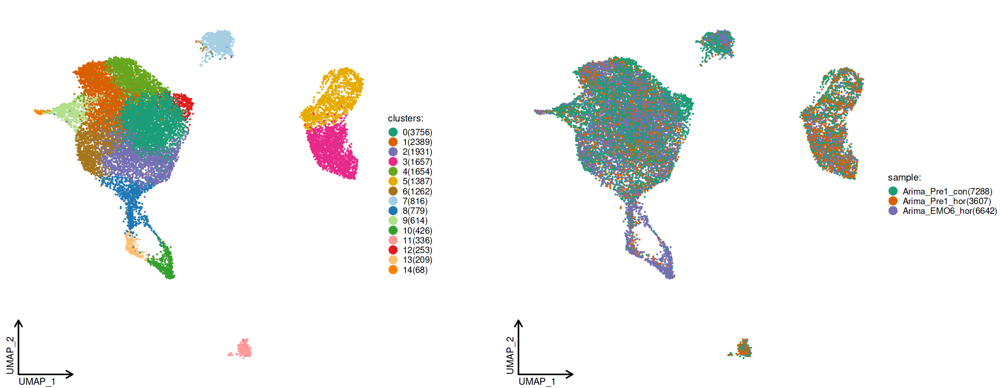

In [46]:
# Using SCP
plot.width = 18
plot.height = 7
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
ClassDimPlot(palcolor = color_palette,
  srt = so.combined.sct, group.by = c("clusters", "sample"),
  reduction = "UMAP", theme_use = "theme_blank"
)
ggsave(file="results/2023-04-28/ari_org_umap_2.pdf", width = plot.width, height = plot.height)

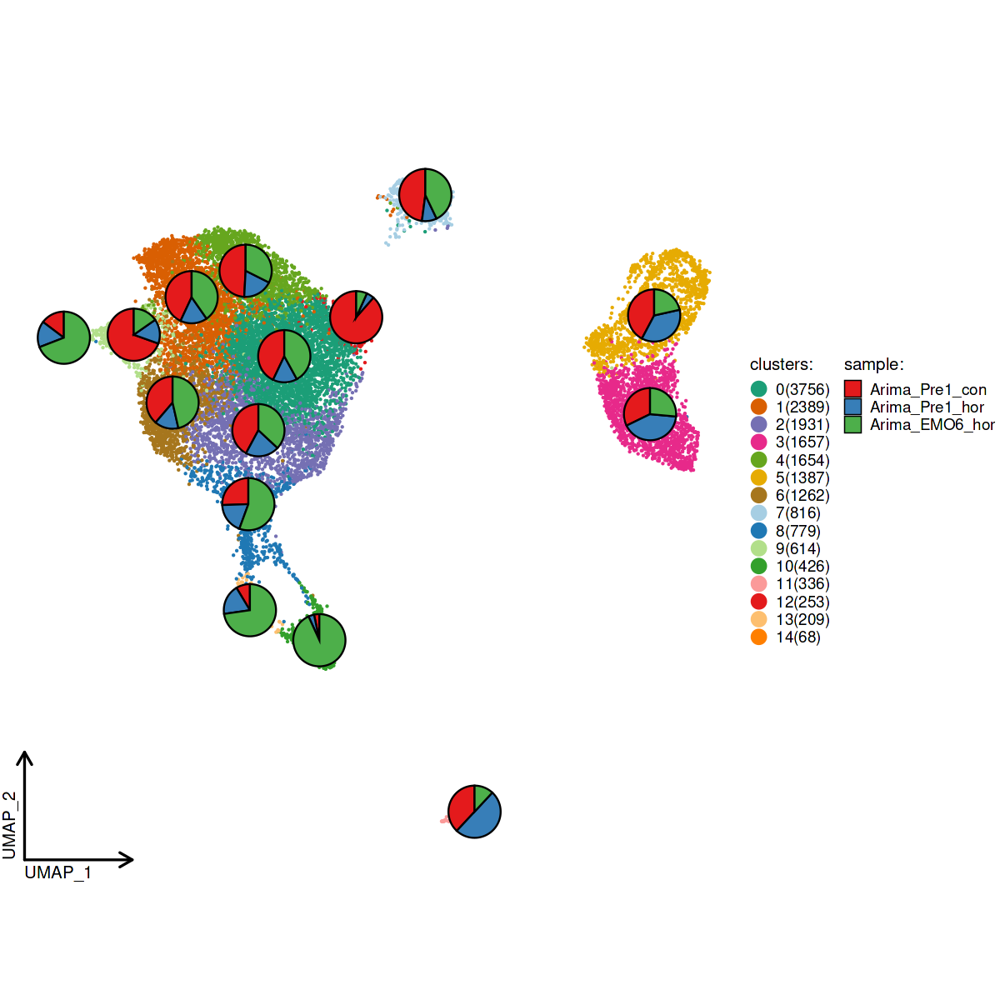

In [47]:
plot.width = 10
plot.height = 10
options(repr.plot.width = plot.width, repr.plot.height = plot.height)

# Using SCP
ClassDimPlot(palcolor = color_palette,
  srt = so.combined.sct, group.by = "clusters", stat.by = "sample",
  reduction = "UMAP", theme_use = "theme_blank"
)
ggsave(file="results/2023-04-28/ari_org_umap_3_proportion_samples.pdf", width = plot.width, height = plot.height)

In [48]:
table(Idents(so.combined.sct), so.combined.sct$sample)

    
     Arima_EMO6_hor Arima_Pre1_con Arima_Pre1_hor
  0            1578           1613            565
  1             963           1028            398
  2             713            814            404
  3             438            534            685
  4             536            813            305
  5             298            586            503
  6             586            489            187
  7             350            391             75
  8             433            199            147
  9              94            427             93
  10            397             14             15
  11             40            128            168
  12             17            224             12
  13            152             18             39
  14             47             10             11

In [49]:
prop.table(table(Idents(so.combined.sct), so.combined.sct$sample), margin = 2)

    
     Arima_EMO6_hor Arima_Pre1_con Arima_Pre1_hor
  0     0.237579042    0.221322722    0.156639867
  1     0.144986450    0.141053787    0.110341004
  2     0.107347185    0.111690450    0.112004436
  3     0.065943993    0.073271131    0.189908511
  4     0.080698585    0.111553238    0.084557804
  5     0.044866004    0.080406147    0.139451067
  6     0.088226438    0.067096597    0.051843637
  7     0.052694971    0.053649835    0.020792903
  8     0.065191207    0.027305159    0.040754089
  9     0.014152364    0.058589462    0.025783199
  10    0.059771153    0.001920966    0.004158581
  11    0.006022282    0.017563117    0.046576102
  12    0.002559470    0.030735456    0.003326864
  13    0.022884673    0.002469813    0.010812309
  14    0.007076182    0.001372119    0.003049626

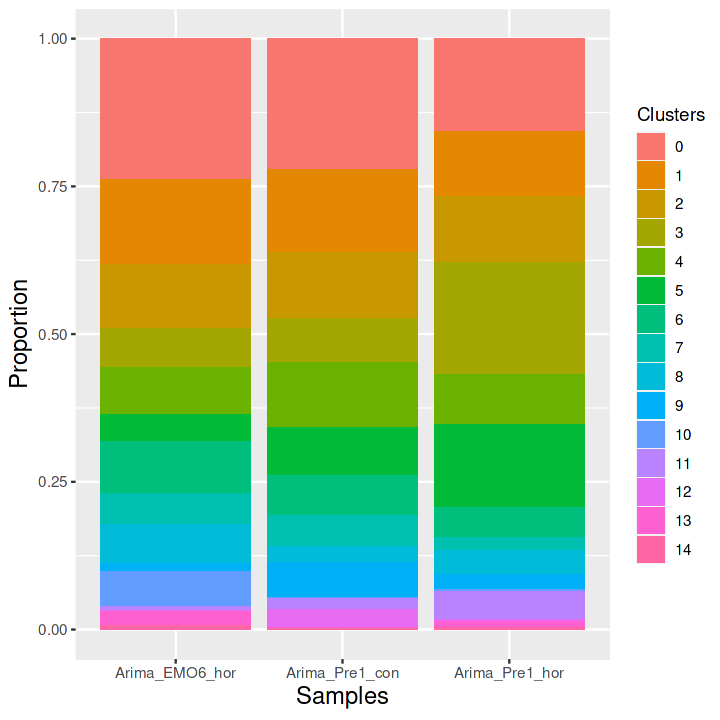

In [50]:
tab = prop.table(table(Idents(so.combined.sct), so.combined.sct$sample), margin = 2)
tab = as.data.frame(tab)

plot.width = 6
plot.height = 6
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
ggplot(tab,aes(x=Var2,y=Freq,fill=Var1)) + geom_col() + scale_color_manual(color_palette) +
    theme(
        plot.title = element_text(size=14), 
        axis.title.x = element_text(size = 14),
        axis.title.y = element_text(size = 14),
    ) +
    xlab("Samples") + ylab("Proportion") + labs(fill = "Clusters")
ggsave(file="results/2023-04-28/ari_org_prop_samples.pdf", width = plot.width, height = plot.height)

In [51]:
saveRDS(so.combined.sct, file = "data/ari_org/ari_org_integrated.rds")

In [52]:
so.combined.sct

An object of class Seurat 
81018 features across 17537 samples within 3 assays 
Active assay: integrated (24081 features, 3000 variable features)
 2 other assays present: RNA, SCT
 3 dimensional reductions calculated: pca, umap, tsne

In [53]:
table(so.combined.sct@meta.data$sample)


Arima_EMO6_hor Arima_Pre1_con Arima_Pre1_hor 
          6642           7288           3607 

In [54]:
table(so.combined.sct$clusters[so.combined.sct$sample == "Arima_Pre1_con"])


   0    1    2    3    4    5    6    7    8    9   10   11   12   13   14 
1613 1028  814  534  813  586  489  391  199  427   14  128  224   18   10 

In [55]:
length(unique(so.combined.sct$sample))

[1] 3

In [56]:
library(ggplot2)

# Calculate the relative frequencies of the table
data_table_rel1 <- prop.table(as.matrix(table(so.combined.sct$clusters[so.combined.sct$sample == "Arima_Pre1_con"])))
data_table_rel1$sample <- "Pre1_con"

# Calculate the relative frequencies of the table
data_table_rel2 <- prop.table(as.matrix(table(so.combined.sct$clusters[so.combined.sct$sample == "Arima_Pre1_hor"])))
data_table_rel2$sample <- "Pre1_hor"

# Calculate the relative frequencies of the table
data_table_rel3 <- prop.table(as.matrix(table(so.combined.sct$clusters[so.combined.sct$sample == "Arima_EMO6_hor"])))
data_table_rel3$sample <- "EMO6_hor"

# Combine the two tables vertically using rbind()
data_table_all <- rbind(data_table_rel1, data_table_rel2, data_table_rel3)

# Convert the matrix to a data frame
data_table_all <- as.data.frame(data_table_all)
#data_table_all

names <- rownames(data_table_rel1)
num_samples <- length(unique(so.combined.sct$sample))

# Use the same name for both samples
data_table_all$cell_types <- rep(names, num_samples)
data_table_all

# Include label
#data_table_all$Color <- factor(rep(c("Downsampled", "Full"), each = 8))
#data_table_all

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,sample
,<named list>,<named list>,<named list>,<named list>,<named list>,<named list>,<named list>,<named list>,<named list>,<named list>,<named list>,<named list>,<named list>,<named list>,<named list>,<named list>
data_table_rel1,0.221322....,0.141053....,0.111690....,0.073271....,0.111553....,0.080406....,0.067096....,0.053649....,0.027305....,0.058589....,0.001920....,0.017563....,0.030735....,0.002469....,0.001372....,Pre1_con
data_table_rel2,0.156639....,0.110341....,0.112004....,0.189908....,0.084557....,0.139451....,0.051843....,0.020792....,0.040754....,0.025783....,0.004158....,0.046576....,0.003326....,0.010812....,0.003049....,Pre1_hor
data_table_rel3,0.237579....,0.144986....,0.107347....,0.065943....,0.080698....,0.044866....,0.088226....,0.052694....,0.065191....,0.014152....,0.059771....,0.006022....,0.002559....,0.022884....,0.007076....,EMO6_hor


In [57]:
ari_org_list <- SplitObject(so.combined.sct, split.by = "sample")

In [58]:
ari_org_list

$Arima_Pre1_con
An object of class Seurat 
81018 features across 7288 samples within 3 assays 
Active assay: integrated (24081 features, 3000 variable features)
 2 other assays present: RNA, SCT
 3 dimensional reductions calculated: pca, umap, tsne

$Arima_Pre1_hor
An object of class Seurat 
81018 features across 3607 samples within 3 assays 
Active assay: integrated (24081 features, 3000 variable features)
 2 other assays present: RNA, SCT
 3 dimensional reductions calculated: pca, umap, tsne

$Arima_EMO6_hor
An object of class Seurat 
81018 features across 6642 samples within 3 assays 
Active assay: integrated (24081 features, 3000 variable features)
 2 other assays present: RNA, SCT
 3 dimensional reductions calculated: pca, umap, tsne


In [59]:
as.matrix(ari_org_list$Arima_EMO6_hor@assays$RNA@counts[1:10, 1:10])

,AAACCCAAGATGCTGG-1_3,AAACCCAAGATTTGCC-1_3,AAACCCAAGTCACTCA-1_3,AAACCCAGTAGTTCCA-1_3,AAACCCAGTGTGATGG-1_3,AAACCCAGTGTTCGTA-1_3,AAACCCATCTTAATCC-1_3,AAACGAAAGACGGTCA-1_3,AAACGAAAGTACTGTC-1_3,AAACGAACAGCGACCT-1_3
AL627309.1,0,0,0,0,0,0,0,0,0,0
AL627309.5,0,0,0,0,0,0,0,0,0,0
AL627309.4,0,0,0,0,0,0,0,0,0,0
AP006222.2,0,0,0,0,0,0,0,0,0,0
AC114498.1,0,0,0,0,0,0,0,0,0,0
AL669831.2,0,0,0,0,0,0,0,0,0,0
LINC01409,3,1,0,1,0,0,0,0,0,0
FAM87B,0,0,0,0,0,0,0,0,0,0
LINC01128,0,0,0,0,0,1,0,0,0,0
LINC00115,0,0,0,0,0,0,0,0,0,0


In [60]:
ari_org_list$Arima_EMO6_hor@assays

$RNA
Assay data with 29404 features for 6642 cells
First 10 features:
 AL627309.1, AL627309.5, AL627309.4, AP006222.2, AC114498.1, AL669831.2,
LINC01409, FAM87B, LINC01128, LINC00115 

$SCT
SCTAssay data with 27533 features for 6642 cells, and 3 SCTModel(s) 
First 10 features:
 AL627309.1, AL627309.5, AL627309.4, AP006222.2, AC114498.1, LINC01409,
FAM87B, LINC01128, LINC00115, FAM41C 

$integrated
SCTAssay data with 24081 features for 6642 cells, and 1 SCTModel(s) 
Top 10 variable features:
 XACT, PRKG1, CDH13, LRFN5, FLT1, AC011246.1, TIMP3, CEMIP, GUCY1A2,
CCDC102B 


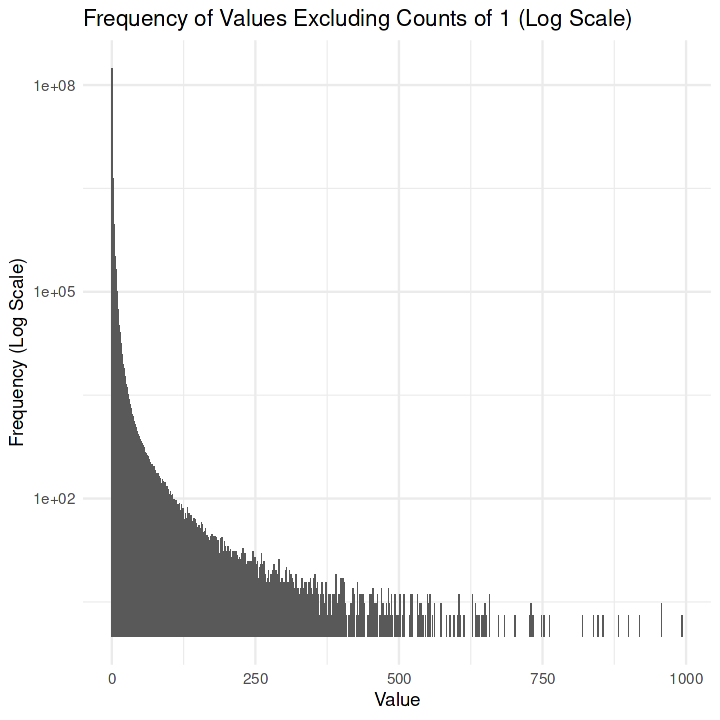

In [61]:
# Calculate the frequency of zeros in the counts excluding 1 
plot_frequency_log <- function(df, round_digits = 2) {
  # Flatten the data frame into a vector
  df_vector <- as.vector(df)
  
  # Check if the vector contains only numeric values
  if (!all(sapply(df_vector, is.numeric))) {
    stop("The data frame contains non-numeric values.")
  }
  
  # Round the values in the vector to reduce the number of unique elements
  df_vector_rounded <- round(df_vector, round_digits)
  
  # Calculate the frequency of values
  value_counts <- table(df_vector_rounded)
  
  # Remove counts with a frequency of 1
  filtered_value_counts <- value_counts[value_counts != 1]
  
  # Convert the table to a data frame for ggplot2
  filtered_value_counts_df <- data.frame(value = as.numeric(names(filtered_value_counts)), count = as.numeric(filtered_value_counts))
  
  # Create a histogram of the value frequencies with a log scale on the y-axis
  plot <- ggplot(filtered_value_counts_df, aes(x = value, y = count)) +
    geom_col() +
    scale_y_log10() +
    labs(title = "Frequency of Values Excluding Counts of 1 (Log Scale)", x = "Value", y = "Frequency (Log Scale)") +
    theme_minimal()
  
  return(plot)
}

# Example usage
df <- as.matrix(ari_org_list$Arima_EMO6_hor@assays$RNA@counts)
frequency_plot_log <- plot_frequency_log(df)
print(frequency_plot_log)

In [62]:
ari_org_list

$Arima_Pre1_con
An object of class Seurat 
81018 features across 7288 samples within 3 assays 
Active assay: integrated (24081 features, 3000 variable features)
 2 other assays present: RNA, SCT
 3 dimensional reductions calculated: pca, umap, tsne

$Arima_Pre1_hor
An object of class Seurat 
81018 features across 3607 samples within 3 assays 
Active assay: integrated (24081 features, 3000 variable features)
 2 other assays present: RNA, SCT
 3 dimensional reductions calculated: pca, umap, tsne

$Arima_EMO6_hor
An object of class Seurat 
81018 features across 6642 samples within 3 assays 
Active assay: integrated (24081 features, 3000 variable features)
 2 other assays present: RNA, SCT
 3 dimensional reductions calculated: pca, umap, tsne


In [63]:
# Save files for EEISP and network analsys

write.table(as.matrix(ari_org_list$Arima_EMO6_hor@assays$RNA@counts), 
            'results/2023-04_EEISP/EMO6_hor_counts.tsv', 
            sep = '\t', row.names = T, col.names = T, quote = F)

In [64]:
# Save files for EEISP and network analsys

write.table(as.matrix(ari_org_list$Arima_Pre1_hor@assays$RNA@counts), 
            'results/2023-04_EEISP/Pre1_hor_counts.tsv', 
            sep = '\t', row.names = T, col.names = T, quote = F)

In [65]:
# Save files for EEISP and network analsys

write.table(as.matrix(ari_org_list$Arima_Pre1_con@assays$RNA@counts), 
            'results/2023-04_EEISP/Pre1_con_counts.tsv', 
            sep = '\t', row.names = T, col.names = T, quote = F)

# DEG identification amongst the samples (ALL CELLS)

Here we use pairwise comparison between samples:

1. Pre1: control and hormone
2. Pre1_hormone and EMO6_hormone
3. Pre1_control and Pre1_hor + EMO6_hor

In [66]:
so.combined.sct <- readRDS(file = "data/ari_org/ari_org_integrated.rds")

In [67]:
so.combined.sct

An object of class Seurat 
81018 features across 17537 samples within 3 assays 
Active assay: integrated (24081 features, 3000 variable features)
 2 other assays present: RNA, SCT
 3 dimensional reductions calculated: pca, umap, tsne

In [68]:
table(so.combined.sct$clusters)


   0    1    2    3    4    5    6    7    8    9   10   11   12   13   14 
3756 2389 1931 1657 1654 1387 1262  816  779  614  426  336  253  209   68 

In [69]:
# Switch the current ident to the cell tpe"
Idents(so.combined.sct) <- so.combined.sct$sample

In [70]:
# For the differential expression analsyis, we use the corrected counts, instesad of the eaw counts.

In [71]:
table(Idents(so.combined.sct))


Arima_Pre1_con Arima_Pre1_hor Arima_EMO6_hor 
          7288           3607           6642 

In [72]:
DefaultAssay(so.combined.sct) <- "SCT"

In [73]:
so.combined.sct <- PrepSCTFindMarkers(so.combined.sct)

Found 3 SCT models. Recorrecting SCT counts using minimum median counts: 6592



# 1.Pre1: hormone over control

In [74]:
pre1_hormone.response <- FindMarkers(so.combined.sct, assay = "SCT", ident.1 = "Arima_Pre1_hor", 
                                ident.2 = "Arima_Pre1_con", min.pct = 0.25, logfc.threshold = 0.25,
                                verbose = FALSE)

# There are genes with P-val adjust of 1 or not significative.
head(pre1_hormone.response, n = 10)
tail(pre1_hormone.response, n = 10)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
DHRS3,0.000000e+00,-1.1787931,0.515,0.878,0.000000e+00
PROM1,0.000000e+00,-1.0445150,0.708,0.961,0.000000e+00
PLXNA4,0.000000e+00,-1.7798274,0.059,0.474,0.000000e+00
ROR2,0.000000e+00,-0.9975723,0.483,0.792,0.000000e+00
ABLIM1,0.000000e+00,-0.8657425,0.640,0.892,0.000000e+00
PTPRJ,0.000000e+00,-0.8874483,0.782,0.959,0.000000e+00
TIAM1,0.000000e+00,-1.0409970,0.457,0.800,0.000000e+00
ITPR2,1.168952e-304,-0.7466626,0.721,0.912,3.218476e-300
KIAA1217,5.968201e-300,-0.7624698,0.855,0.979,1.643225e-295


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
MPPED2,1.042642e-05,0.4556677,0.319,0.308,0.2870707
PAX8-AS1,5.320349e-04,0.2944945,0.648,0.689,1.0000000
CPA6,7.292043e-04,0.6127379,0.375,0.365,1.0000000
LINC01320,1.603414e-03,0.4346662,0.442,0.510,1.0000000
HMGA2,1.794690e-03,0.7184200,0.812,0.862,1.0000000
PLCB1,5.173345e-03,0.4143633,0.684,0.811,1.0000000
MBP,2.142725e-01,0.2644032,0.578,0.653,1.0000000
LINC02582,5.994295e-01,0.3919188,0.394,0.418,1.0000000
RHEX,6.318855e-01,0.4482926,0.848,0.954,1.0000000


In [75]:
# Filter out non-significant genes and order by average log2-foldchange
pre1_hormone.response_upregulated <- pre1_hormone.response %>% 
                                      filter(p_val_adj < 0.05) %>% 
                                      filter(avg_log2FC > 0) %>%     # get values expressed only in Pre1 hormone
                                      arrange(avg_log2FC)
head(pre1_hormone.response_upregulated)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
EXT1,3.865773e-12,0.2500344,0.975,0.980,1.064363e-07
IFI16,3.869210e-41,0.2504041,0.391,0.275,1.065310e-36
TACC1,3.072009e-54,0.2508429,0.386,0.249,8.458163e-50
CGGBP1,4.923538e-43,0.2520431,0.453,0.334,1.355598e-38
SEC14L1,9.197929e-19,0.2522360,0.585,0.516,2.532466e-14
LINC01812,2.060971e-17,0.2535498,0.342,0.272,5.674472e-13


In [76]:
# Filter out non-significant genes and order by average log2-foldchange
pre1_hormone.response_downregulated <- pre1_hormone.response %>% 
                                      filter(p_val_adj < 0.05) %>% 
                                      filter(avg_log2FC < 0) %>%     # get values expressed only in Pre1 hormone
                                      arrange(avg_log2FC)
head(pre1_hormone.response_downregulated)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
PLXNA4,0.000000e+00,-1.7798274,0.059,0.474,0.000000e+00
DHRS3,0.000000e+00,-1.1787931,0.515,0.878,0.000000e+00
NOSTRIN,3.095341e-288,-1.0967942,0.160,0.513,8.522402e-284
PROM1,0.000000e+00,-1.0445150,0.708,0.961,0.000000e+00
TIAM1,0.000000e+00,-1.0409970,0.457,0.800,0.000000e+00
ROR2,0.000000e+00,-0.9975723,0.483,0.792,0.000000e+00


[1] "LINC00621"  "AL356277.3" "SLC7A2"     "FAM155A"    "ASRGL1"

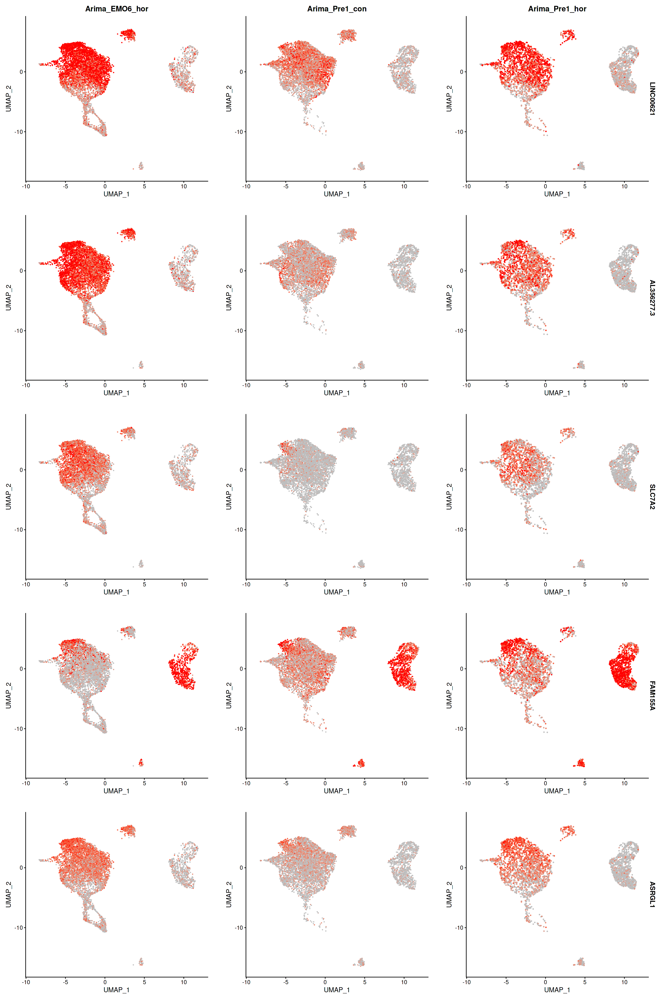

In [77]:
# Use corrected values to observe gene expression changes
DefaultAssay(so.combined.sct) <- "SCT"

upregulated_to_plot <- pre1_hormone.response_upregulated %>% 
                            slice_max(n = 5, order_by = avg_log2FC) %>%
                            rownames

upregulated_to_plot

plot.width = 20
plot.height = 30
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
FeaturePlot(so.combined.sct, features = upregulated_to_plot, split.by = "sample", max.cutoff = 3,
    cols = c("grey", "red"))
ggsave(file="results/2023-04-26/Pre1_hor_up_top5.pdf", width = plot.width, height = plot.height)

[1] "PLXNA4"  "DHRS3"   "NOSTRIN" "PROM1"   "TIAM1"

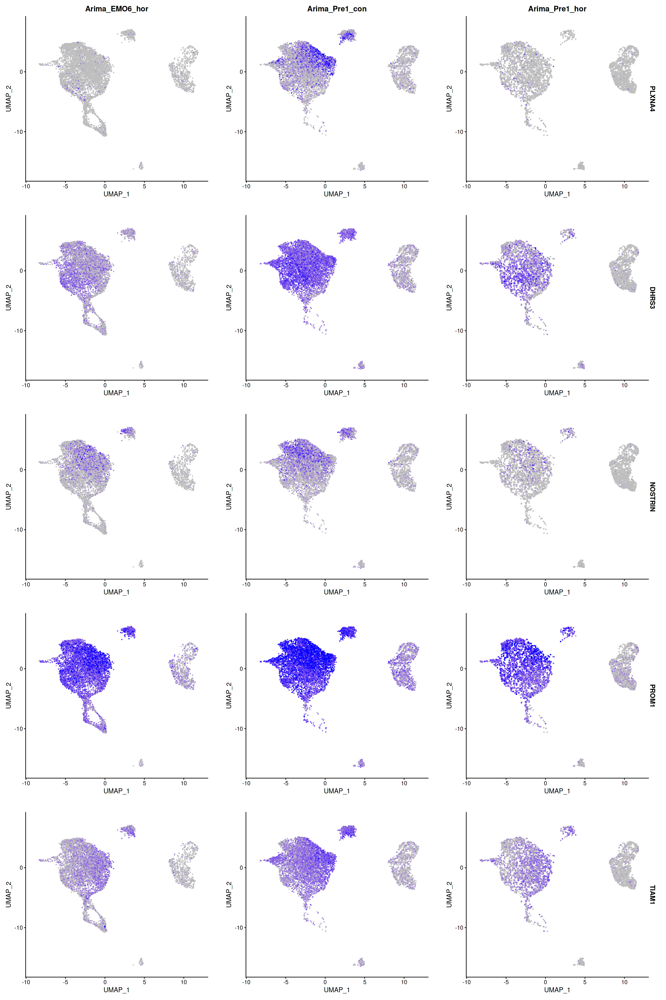

In [78]:
# Use corrected values to observe gene expression changes
DefaultAssay(so.combined.sct) <- "SCT"

downregulated_to_plot <- pre1_hormone.response_downregulated %>% 
                            slice_max(n = 5, order_by = -avg_log2FC) %>%
                            rownames

downregulated_to_plot

plot.width = 20
plot.height = 30
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
FeaturePlot(so.combined.sct, features = downregulated_to_plot, split.by = "sample", max.cutoff = 3,
    cols = c("grey", "blue"))
ggsave(file="results/2023-04-26/Pre1_hor_down_top5.pdf", width = plot.width, height = plot.height)

In [79]:
# Save files

pre1_hormone.response_upregulated$genes <- rownames(pre1_hormone.response_upregulated)

write.table(as.matrix(pre1_hormone.response_upregulated), 
            'results/2023-04-26/Pre1_hor_up.tsv', 
            sep = '\t', row.names = F, col.names = T, quote = F)

In [80]:
# Save files 

pre1_hormone.response_downregulated$genes <- rownames(pre1_hormone.response_downregulated)

write.table(as.matrix(pre1_hormone.response_downregulated), 
            'results/2023-04-26/Pre1_hor_down.tsv', 
            sep = '\t', row.names = F, col.names = T, quote = F)

In [81]:
# GO term enrichment analysis on the clusters
# Make a list of allgenes to be the background for the enrichment analysis
pre1_hormone_up_converted_genes <- na.omit(convertID(pre1_hormone.response_upregulated$genes))
ngenes <- length(pre1_hormone_up_converted_genes)
ngenes

'select()' returned 1:1 mapping between keys and columns



[1] 343

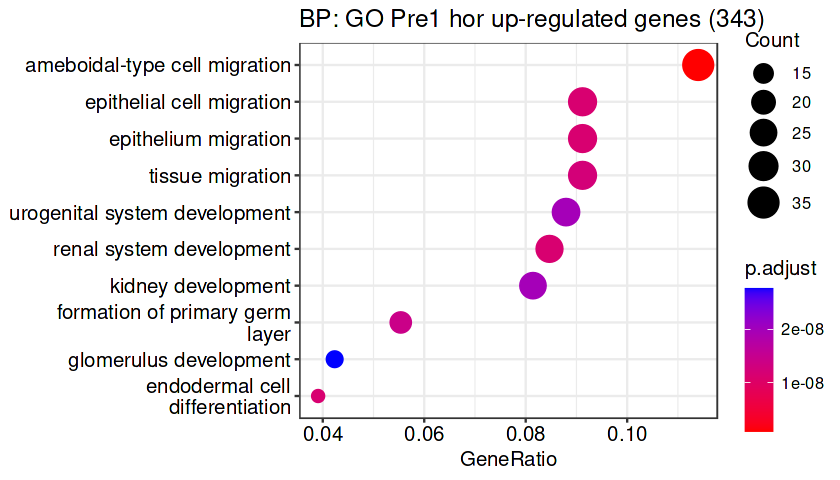

In [82]:
title = paste0("BP: GO Pre1 hor up-regulated genes (", ngenes, ")")

plot.width = 7
plot.height = 4
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
go_func(pre1_hormone_up_converted_genes, title) 
ggsave(file="results/2023-04-26/GO_Pre1_hor_up_dot.pdf", width = plot.width, height = plot.height) 

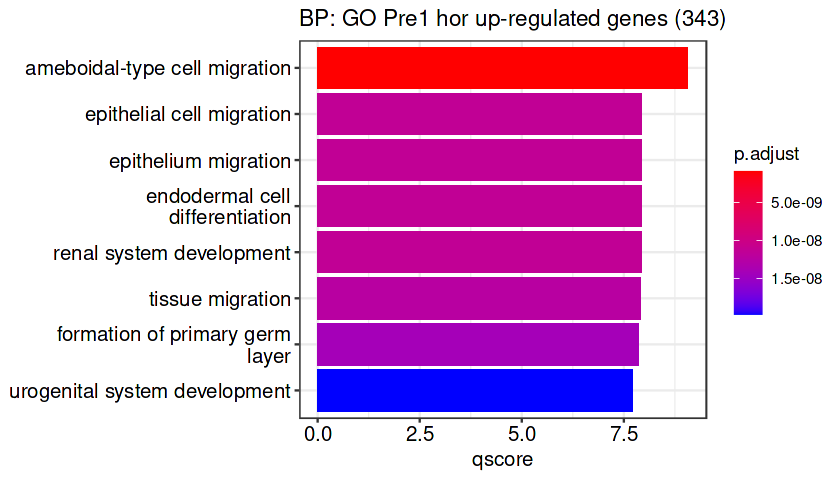

In [83]:
title = paste0("BP: GO Pre1 hor up-regulated genes (", ngenes, ")")

plot.width = 7
plot.height = 4
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
go_func2(pre1_hormone_up_converted_genes, title) 
ggsave(file="results/2023-04-26/GO_Pre1_hor_up_bar.pdf", width = plot.width, height = plot.height) 

In [84]:
# GO term enrichment analysis on the clusters
# Make a list of allgenes to be the background for the enrichment analysis
pre1_hormone_down_converted_genes <- na.omit(convertID(pre1_hormone.response_downregulated$genes))
ngenes <- length(pre1_hormone_down_converted_genes)
ngenes

'select()' returned 1:1 mapping between keys and columns



[1] 303

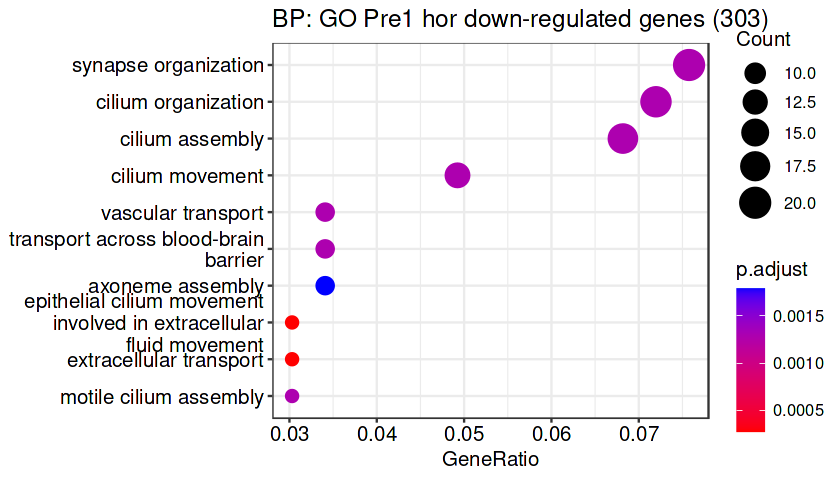

In [85]:
title = paste0("BP: GO Pre1 hor down-regulated genes (", ngenes, ")")

plot.width = 7
plot.height = 4
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
go_func(pre1_hormone_down_converted_genes, title) 
ggsave(file="results/2023-04-26/GO_Pre1_hor_down_dot.pdf", width = plot.width, height = plot.height) 

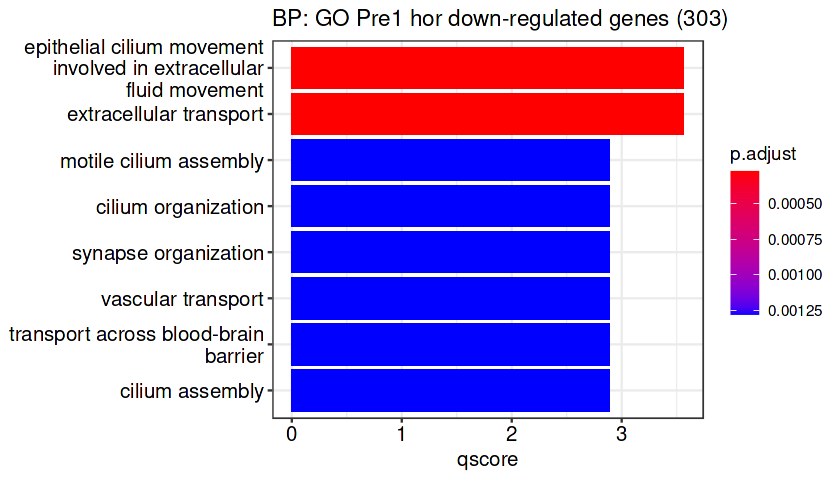

In [86]:
title = paste0("BP: GO Pre1 hor down-regulated genes (", ngenes, ")")

plot.width = 7
plot.height = 4
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
go_func2(pre1_hormone_down_converted_genes, title) 
ggsave(file="results/2023-04-26/GO_Pre1_hor_down_bar.pdf", width = plot.width, height = plot.height) 

### 2.Pre1_hormone and EMO6_hormone

In [87]:
EMO6_over_Pre1_hor <- FindMarkers(so.combined.sct, assay = "SCT", ident.1 = "Arima_EMO6_hor", 
                                ident.2 = "Arima_Pre1_hor", min.pct = 0.25, logfc.threshold = 0.25,
                                verbose = FALSE)

# There are genes with P-val adjust of 1 or not significative.
head(EMO6_over_Pre1_hor, n = 10)
tail(EMO6_over_Pre1_hor, n = 10)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
CHRM3,0,-0.8093933,0.054,0.331,0
AL356277.3,0,1.3058589,0.871,0.582,0
IGF2BP3,0,0.9132852,0.826,0.472,0
CALB1,0,1.0865571,0.838,0.420,0
KLF12,0,-0.7765346,0.108,0.449,0
FAM155A,0,-1.3792484,0.455,0.851,0
LINC02315,0,1.2196313,0.467,0.009,0
WSB1,0,0.8380216,0.992,0.966,0
AC011476.3,0,-0.4404077,0.043,0.310,0


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
KNOP1,0.03213248,0.2548328,0.256,0.243,1
GULP1,0.07843865,0.2556021,0.565,0.591,1
ARSG,0.09417464,0.3215571,0.299,0.314,1
P2RX4,0.10678041,0.7401532,0.271,0.293,1
LRIG1,0.31197913,-0.3603769,0.687,0.657,1
POLR2B,0.42010547,0.2593244,0.479,0.497,1
FLOT1,0.53787948,0.5257970,0.318,0.319,1
FUT10,0.59956174,0.5408841,0.368,0.376,1
DCAF7,0.66137983,0.3747637,0.514,0.528,1


In [88]:
# Filter out non-significant genes and order by average log2-foldchange
EMO6_over_Pre1_hor_upregulated <- EMO6_over_Pre1_hor %>% 
                                      filter(p_val_adj < 0.05) %>% 
                                      filter(avg_log2FC > 0) %>%     # get values expressed only in Pre1 hormone
                                      arrange(avg_log2FC)
head(EMO6_over_Pre1_hor_upregulated)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
SERINC5,2.641116e-34,0.2500649,0.743,0.652,7.271786e-30
MTCP1,1.837010e-33,0.2508857,0.410,0.300,5.057841e-29
PKP4,5.778504e-41,0.2509700,0.893,0.819,1.590995e-36
MYEF2,2.955137e-39,0.2511894,0.525,0.409,8.136377e-35
TBXAS1,9.182371e-40,0.2511905,0.325,0.206,2.528182e-35
SYNE2,1.527998e-49,0.2521305,0.875,0.753,4.207038e-45


In [89]:
# Filter out non-significant genes and order by average log2-foldchange
EMO6_over_Pre1_hor_downregulated <- EMO6_over_Pre1_hor %>% 
                                      filter(p_val_adj < 0.05) %>% 
                                      filter(avg_log2FC < 0) %>%     # get values expressed only in Pre1 hormone
                                      arrange(avg_log2FC)
head(EMO6_over_Pre1_hor_downregulated)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
CDH13,2.211868e-299,-1.821406,0.223,0.566,6.089937e-295
PRKG1,5.077543e-244,-1.535728,0.206,0.512,1.398000e-239
FAM155A,0.000000e+00,-1.379248,0.455,0.851,0.000000e+00
COL6A3,1.929002e-229,-1.356204,0.249,0.542,5.311121e-225
FLT1,4.758188e-220,-1.311080,0.178,0.457,1.310072e-215
ZEB1,1.089427e-250,-1.299700,0.193,0.499,2.999518e-246


[1] "SERPINB9"   "AL079338.1" "ZC3H3"      "MACROD2"    "TXNRD1"

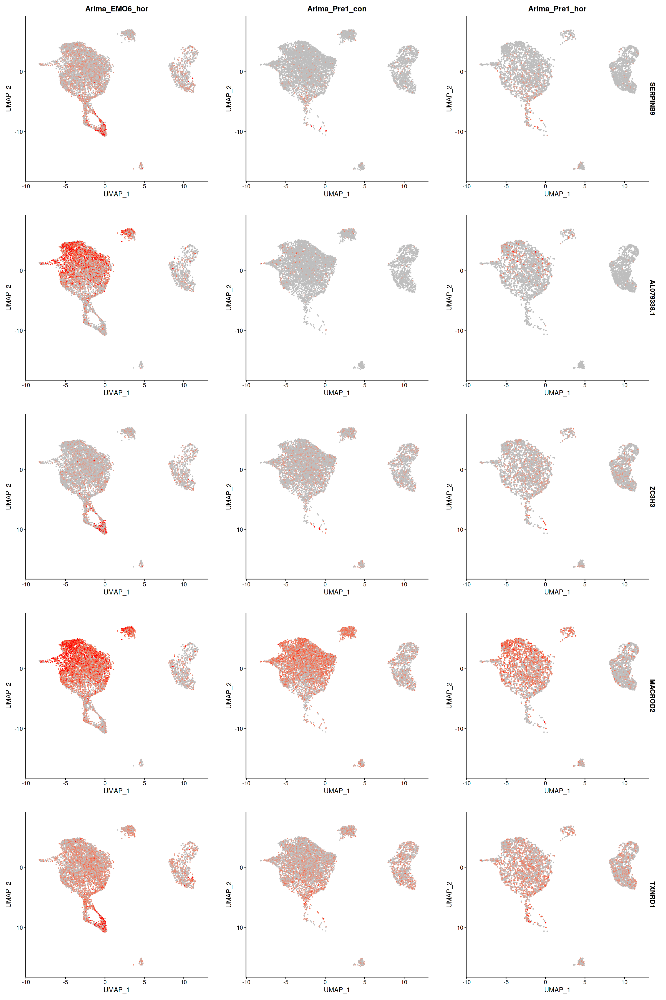

In [90]:
# Use corrected values to observe gene expression changes
DefaultAssay(so.combined.sct) <- "SCT"

upregulated_to_plot <- EMO6_over_Pre1_hor_upregulated %>% 
                            slice_max(n = 5, order_by = avg_log2FC) %>%
                            rownames

upregulated_to_plot

plot.width = 20
plot.height = 30
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
FeaturePlot(so.combined.sct, features = upregulated_to_plot, split.by = "sample", max.cutoff = 3,
    cols = c("grey", "red"))
ggsave(file="results/2023-04-26/EMO6_over_Pre1_hor_up_top5.pdf", width = plot.width, height = plot.height)

[1] "CDH13"   "PRKG1"   "FAM155A" "COL6A3"  "FLT1"

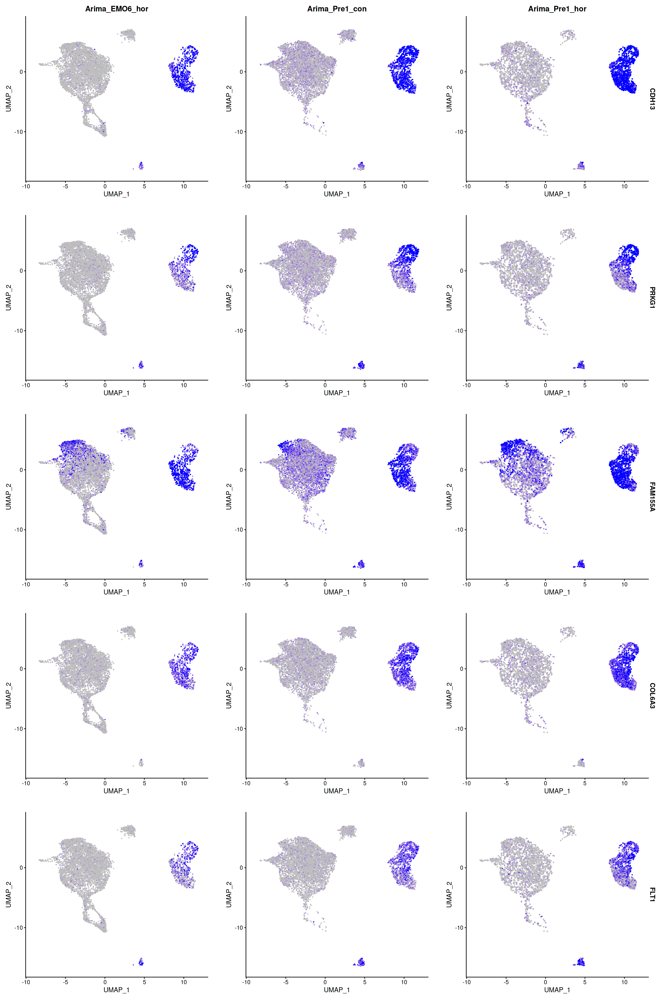

In [91]:
# Use corrected values to observe gene expression changes
DefaultAssay(so.combined.sct) <- "SCT"

downregulated_to_plot <- EMO6_over_Pre1_hor_downregulated %>% 
                            slice_max(n = 5, order_by = -avg_log2FC) %>%
                            rownames

downregulated_to_plot

plot.width = 20
plot.height = 30
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
FeaturePlot(so.combined.sct, features = downregulated_to_plot, split.by = "sample", max.cutoff = 3,
    cols = c("grey", "blue"))
ggsave(file="results/2023-04-26/EMO6_over_Pre1_hor_down_top5.pdf", width = plot.width, height = plot.height)

In [92]:
# Save files

EMO6_over_Pre1_hor_upregulated$genes <- rownames(EMO6_over_Pre1_hor_upregulated)

write.table(as.matrix(EMO6_over_Pre1_hor_upregulated), 
            'results/2023-04-26/EMO6_over_Pre1_hor_up.tsv', 
            sep = '\t', row.names = F, col.names = T, quote = F)

In [93]:
# Save files 

EMO6_over_Pre1_hor_downregulated$genes <- rownames(EMO6_over_Pre1_hor_downregulated)

write.table(as.matrix(EMO6_over_Pre1_hor_downregulated), 
            'results/2023-04-26/EMO6_over_Pre1_hor_down.tsv', 
            sep = '\t', row.names = F, col.names = T, quote = F)

In [94]:
# GO term enrichment analysis on the clusters
# Make a list of allgenes to be the background for the enrichment analysis
EMO6_over_Pre1_hor_upregulated_converted_genes <- na.omit(convertID(EMO6_over_Pre1_hor_upregulated$genes))
ngenes <- length(EMO6_over_Pre1_hor_upregulated_converted_genes)
ngenes

'select()' returned 1:1 mapping between keys and columns



[1] 266

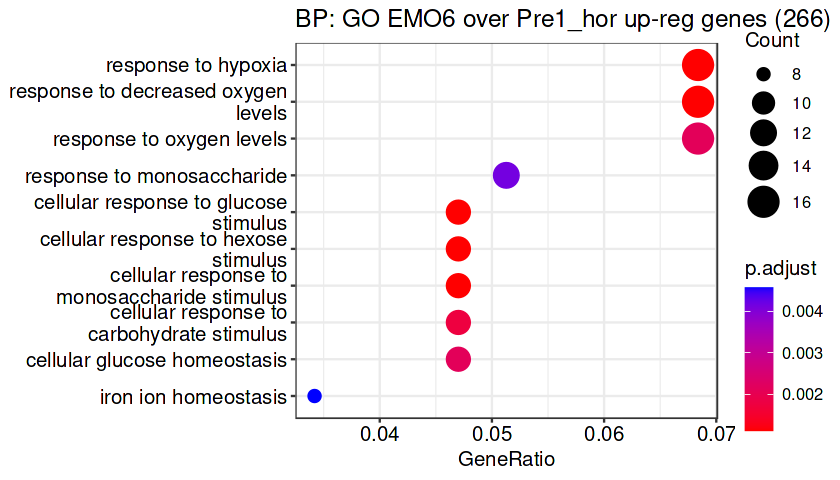

In [95]:
title = paste0("BP: GO EMO6 over Pre1_hor up-reg genes (", ngenes, ")")

plot.width = 7
plot.height = 4
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
go_func(EMO6_over_Pre1_hor_upregulated_converted_genes, title) 
ggsave(file="results/2023-04-26/GO_EMO6_over_Pre1_hor_up_dot.pdf", width = plot.width, height = plot.height) 

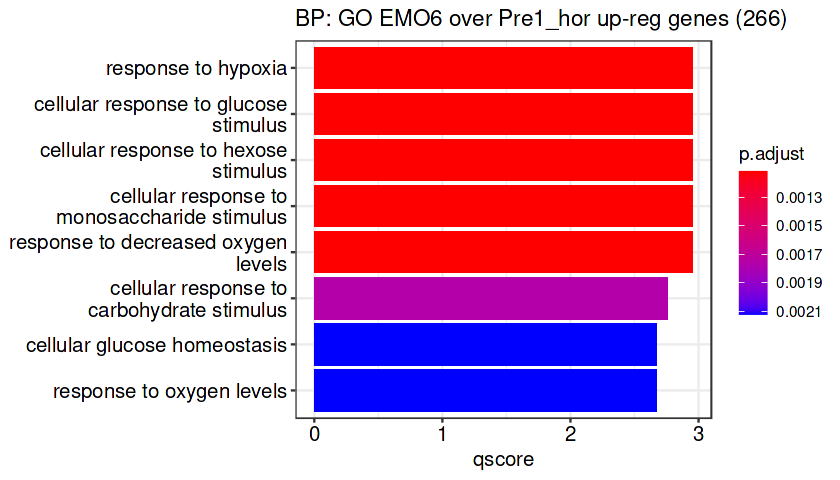

In [96]:
title = paste0("BP: GO EMO6 over Pre1_hor up-reg genes (", ngenes, ")")

plot.width = 7
plot.height = 4
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
go_func2(EMO6_over_Pre1_hor_upregulated_converted_genes, title) 
ggsave(file="results/2023-04-26/GO_EMO6_over_Pre1_hor_up_bar.pdf", width = plot.width, height = plot.height) 

In [97]:
# GO term enrichment analysis on the clusters
# Make a list of allgenes to be the background for the enrichment analysis
EMO6_over_Pre1_hor_downregulated_converted_genes <- na.omit(convertID(EMO6_over_Pre1_hor_downregulated$genes))
ngenes <- length(EMO6_over_Pre1_hor_downregulated_converted_genes)
ngenes

'select()' returned 1:1 mapping between keys and columns



[1] 578

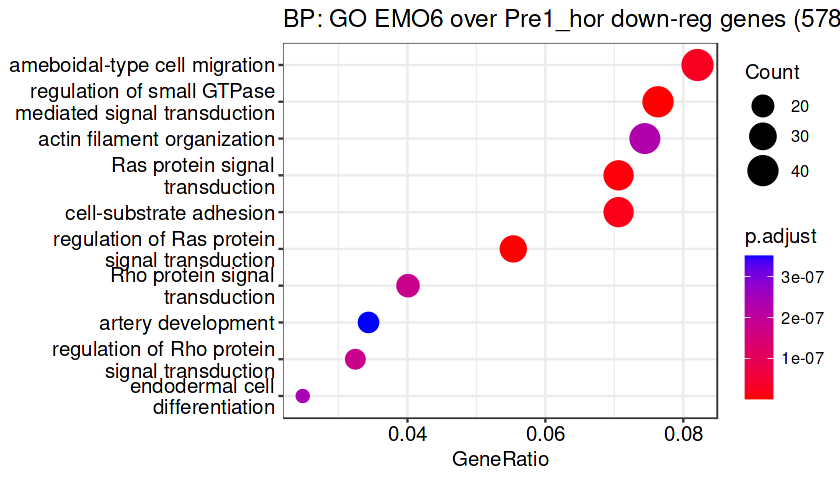

In [98]:
title = paste0("BP: GO EMO6 over Pre1_hor down-reg genes (", ngenes, ")")

plot.width = 7
plot.height = 4
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
go_func(EMO6_over_Pre1_hor_downregulated_converted_genes, title) 
ggsave(file="results/2023-04-26/GO_EMO6_over_Pre1_hor_down_dot.pdf", width = plot.width, height = plot.height) 

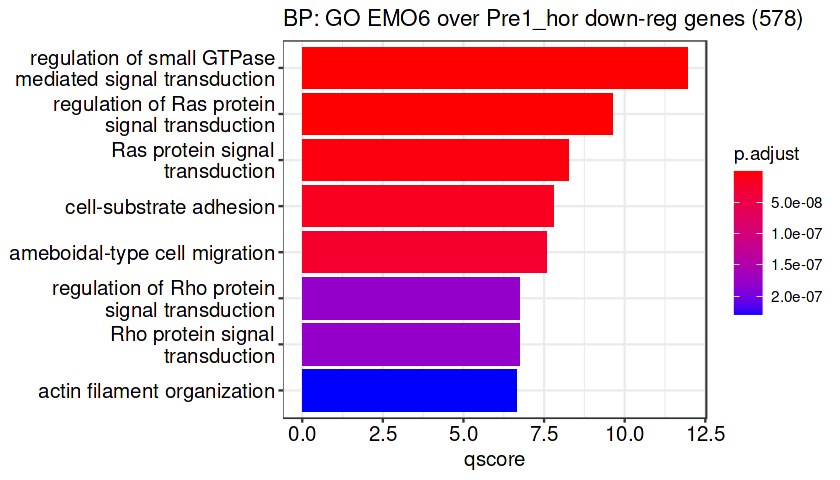

In [99]:
title = paste0("BP: GO EMO6 over Pre1_hor down-reg genes (", ngenes, ")")

plot.width = 7
plot.height = 4
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
go_func2(EMO6_over_Pre1_hor_downregulated_converted_genes, title) 
ggsave(file="results/2023-04-26/GO_EMO6_over_Pre1_hor_down_bar.pdf", width = plot.width, height = plot.height) 

# 3.Pre1_hor+EMO6_hor vs Pre1_control

In [100]:
all_hor_vs_con <- FindMarkers(so.combined.sct, assay = "SCT", ident.1 = c("Arima_EMO6_hor", "Arima_Pre1_hor"), 
                                ident.2 = "Arima_Pre1_con", min.pct = 0.25, logfc.threshold = 0.25,
                                verbose = FALSE)

# There are genes with P-val adjust of 1 or not significative.
head(all_hor_vs_con, n = 10)
tail(all_hor_vs_con, n = 10)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
DHRS3,0,-1.2971840,0.547,0.878,0
VAV3,0,-0.6463398,0.414,0.675,0
CHRM3,0,-1.4431792,0.151,0.677,0
KIF26B,0,-0.8877204,0.477,0.777,0
ALKAL2,0,0.8150104,0.373,0.044,0
AC105450.1,0,-0.8706688,0.154,0.457,0
CAPN13,0,-0.9863324,0.392,0.657,0
AC012593.1,0,1.3144425,0.410,0.144,0
TMSB10,0,1.0660697,0.541,0.235,0


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
SGSM3,0.0005360271,0.3560768,0.283,0.309,1
GCNT2,0.0015029165,0.2854764,0.581,0.621,1
AC024230.1,0.0048876843,0.2685178,0.893,0.966,1
P2RX4,0.0422763466,0.5185038,0.279,0.296,1
EYA2,0.1007406745,0.3451026,0.734,0.820,1
SH3RF3,0.1461705027,0.2589564,0.328,0.362,1
ZCCHC10,0.1677759864,0.3172073,0.291,0.283,1
FLOT1,0.1847420992,0.3332745,0.318,0.329,1
TANGO6,0.2864783848,0.3372125,0.280,0.275,1


In [101]:
# Filter out non-significant genes and order by average log2-foldchange
all_hor_vs_con_upregulated <- all_hor_vs_con %>% 
                                    filter(p_val_adj < 0.05) %>% 
                                    filter(avg_log2FC > 0) %>%     
                                    arrange(avg_log2FC)
head(all_hor_vs_con_upregulated)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
BICD1,8.305942e-15,0.2501509,0.889,0.912,2.286875e-10
OVOL2,9.789224e-81,0.2502023,0.302,0.181,2.695267e-76
RNF111,1.724662e-74,0.2508485,0.750,0.669,4.748511e-70
AL117381.1,5.547201e-43,0.2513729,0.367,0.283,1.527311e-38
TSTD3,3.347719e-66,0.2523456,0.456,0.341,9.217275e-62
DENND6A-AS1,4.088104e-112,0.2523491,0.273,0.135,1.125578e-107


In [102]:
# Filter out non-significant genes and order by average log2-foldchange
all_hor_vs_con_downregulated <- all_hor_vs_con %>% 
                                    filter(p_val_adj < 0.05) %>% 
                                    filter(avg_log2FC < 0) %>%     
                                    arrange(avg_log2FC)
head(all_hor_vs_con_downregulated)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
PLXNA4,0,-1.7721873,0.059,0.474,0
CHRM3,0,-1.4431792,0.151,0.677,0
DHRS3,0,-1.2971840,0.547,0.878,0
PTCHD4,0,-1.0496559,0.355,0.740,0
CAPN13,0,-0.9863324,0.392,0.657,0
TIAM1,0,-0.9238287,0.521,0.800,0


[1] "AL356277.3" "SERPINB9"   "LINC00621"  "AL079338.1" "SLC7A2"

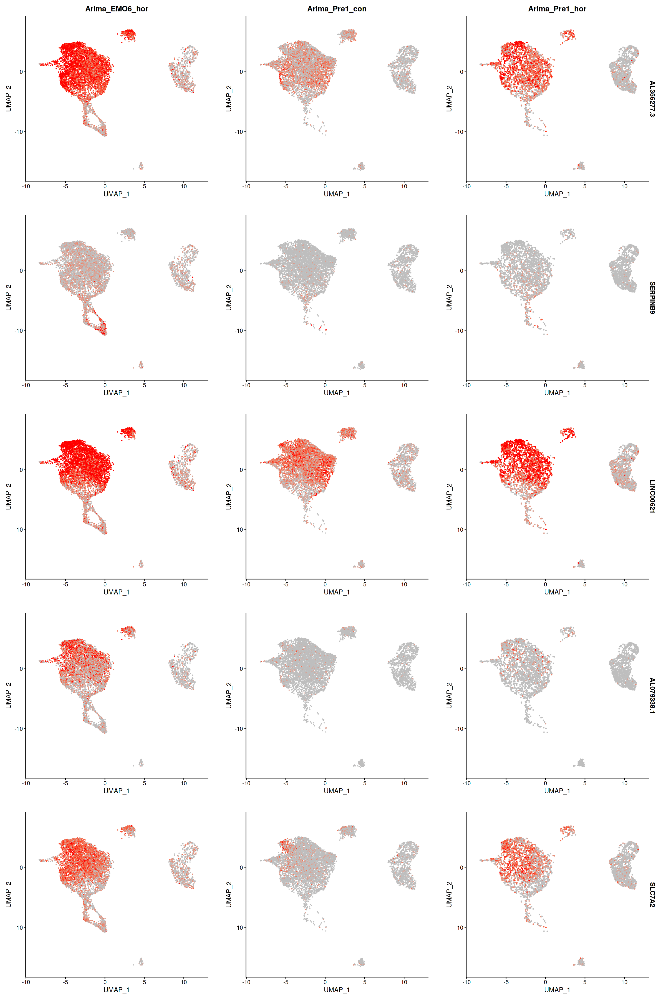

In [103]:
# Use corrected values to observe gene expression changes
DefaultAssay(so.combined.sct) <- "SCT"

upregulated_to_plot <- all_hor_vs_con_upregulated %>% 
                            slice_max(n = 5, order_by = avg_log2FC) %>%
                            rownames

upregulated_to_plot

plot.width = 20
plot.height = 30
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
FeaturePlot(so.combined.sct, features = upregulated_to_plot, split.by = "sample", max.cutoff = 3,
    cols = c("grey", "red"))
ggsave(file="results/2023-04-26/all_hor_vs_con_up_top5.pdf", width = plot.width, height = plot.height)

[1] "PLXNA4" "CHRM3"  "DHRS3"  "PTCHD4" "CAPN13"

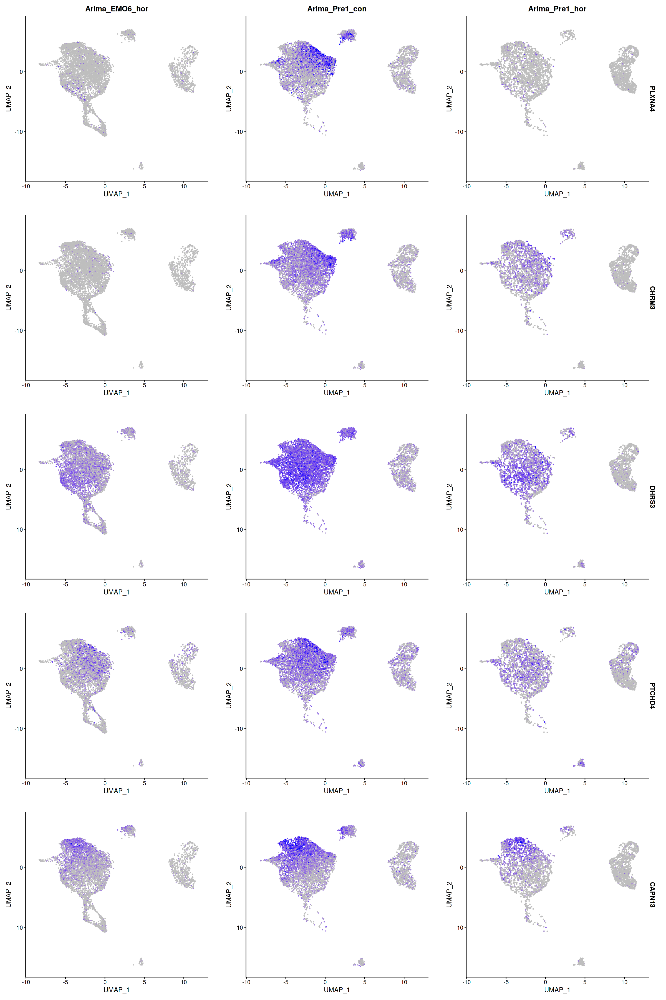

In [104]:
# Use corrected values to observe gene expression changes
DefaultAssay(so.combined.sct) <- "SCT"

downregulated_to_plot <- all_hor_vs_con_downregulated %>% 
                            slice_max(n = 5, order_by = -avg_log2FC) %>%
                            rownames

downregulated_to_plot

plot.width = 20
plot.height = 30
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
FeaturePlot(so.combined.sct, features = downregulated_to_plot, split.by = "sample", max.cutoff = 3,
    cols = c("grey", "blue"))
ggsave(file="results/2023-04-26/all_hor_vs_con_down_top5.pdf", width = plot.width, height = plot.height)

In [105]:
# Save files

all_hor_vs_con_upregulated$genes <- rownames(all_hor_vs_con_upregulated)

write.table(as.matrix(all_hor_vs_con_upregulated), 
            'results/2023-04-26/all_hor_vs_con_up.tsv', 
            sep = '\t', row.names = F, col.names = T, quote = F)

In [106]:
# Save files 

all_hor_vs_con_downregulated$genes <- rownames(all_hor_vs_con_downregulated)

write.table(as.matrix(all_hor_vs_con_downregulated), 
            'results/2023-04-26/all_hor_vs_con_down.tsv', 
            sep = '\t', row.names = F, col.names = T, quote = F)

In [107]:
# GO term enrichment analysis on the clusters
# Make a list of allgenes to be the background for the enrichment analysis
all_hor_vs_con_upregulated_converted_genes <- na.omit(convertID(all_hor_vs_con_upregulated$genes))
ngenes <- length(all_hor_vs_con_upregulated_converted_genes)
ngenes

'select()' returned 1:1 mapping between keys and columns



[1] 276

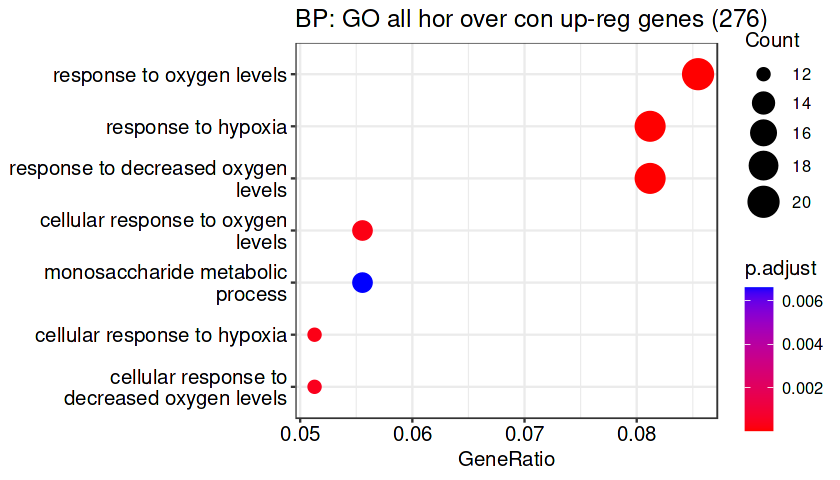

In [108]:
title = paste0("BP: GO all hor over con up-reg genes (", ngenes, ")")

plot.width = 7
plot.height = 4
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
go_func(all_hor_vs_con_upregulated_converted_genes, title) 
ggsave(file="results/2023-04-26/all_hor_vs_con_up_dot.pdf", width = plot.width, height = plot.height) 

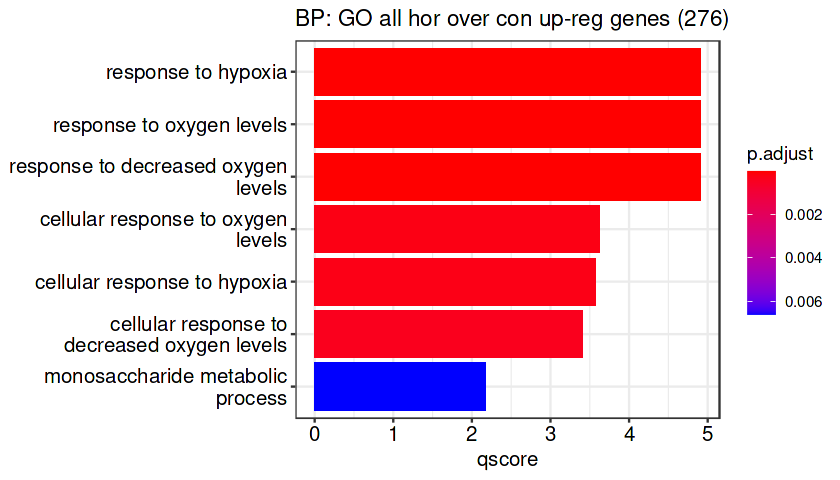

In [109]:
title = paste0("BP: GO all hor over con up-reg genes (", ngenes, ")")

plot.width = 7
plot.height = 4
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
go_func2(all_hor_vs_con_upregulated_converted_genes, title) 
ggsave(file="results/2023-04-26/all_hor_vs_con_up_bar.pdf", width = plot.width, height = plot.height) 

In [110]:
# GO term enrichment analysis on the clusters
# Make a list of allgenes to be the background for the enrichment analysis
all_hor_vs_con_downregulated_converted_genes <- na.omit(convertID(all_hor_vs_con_downregulated$genes))
ngenes <- length(all_hor_vs_con_downregulated_converted_genes)
ngenes

'select()' returned 1:1 mapping between keys and columns



[1] 407

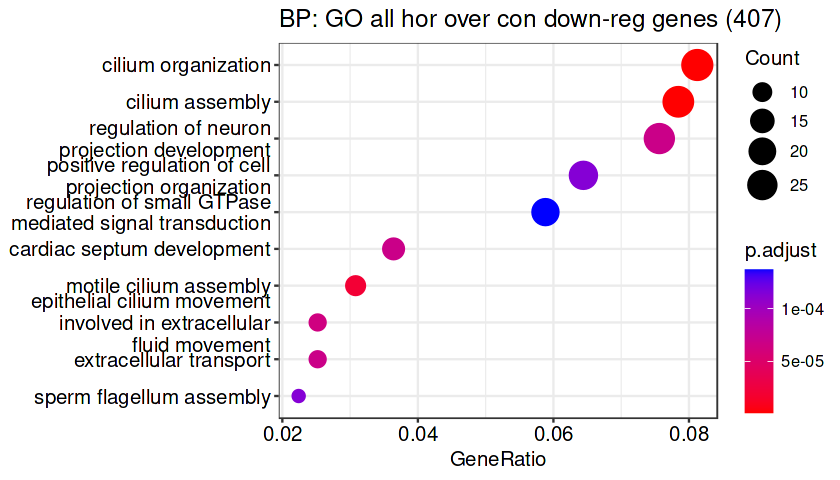

In [111]:
title = paste0("BP: GO all hor over con down-reg genes (", ngenes, ")")

plot.width = 7
plot.height = 4
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
go_func(all_hor_vs_con_downregulated_converted_genes, title) 
ggsave(file="results/2023-04-26/all_hor_vs_con_down_dot.pdf", width = plot.width, height = plot.height) 

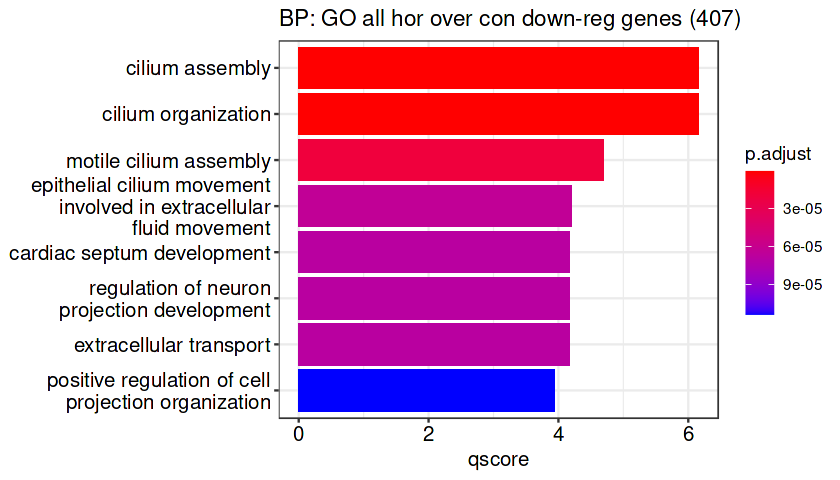

In [112]:
title = paste0("BP: GO all hor over con down-reg genes (", ngenes, ")")

plot.width = 7
plot.height = 4
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
go_func2(all_hor_vs_con_downregulated_converted_genes, title) 
ggsave(file="results/2023-04-26/all_hor_vs_con_down_bar.pdf", width = plot.width, height = plot.height) 

# EMO6_hor vs Pre1_con

In [113]:
EMO6_vs_Pre1_con.response <- FindMarkers(so.combined.sct, assay = "SCT", ident.1 = "Arima_EMO6_hor", 
                                ident.2 = "Arima_Pre1_con",   
                                min.pct = 0.25, logfc.threshold = 0.25,
                                verbose = FALSE)
head(EMO6_vs_Pre1_con.response, n = 10)
tail(EMO6_vs_Pre1_con.response, n = 10)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
VPS13D,0,-0.5805297,0.572,0.799,0
DHRS3,0,-1.3657949,0.564,0.878,0
UQCRH,0,0.8893956,0.562,0.297,0
VAV3,0,-0.7693794,0.372,0.675,0
LYPLAL1,0,0.5795193,0.456,0.134,0
CHRM3,0,-1.7821151,0.054,0.677,0
KIF26B,0,-0.9685281,0.453,0.777,0
ALKAL2,0,0.9744029,0.436,0.044,0
AC105450.1,0,-0.9937478,0.143,0.457,0


,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
USP32,0.01844144,0.2790567,0.620,0.651,1
PAFAH1B1,0.05654465,0.3042977,0.810,0.829,1
LITAF,0.07405149,0.2742364,0.545,0.541,1
FRMD4A,0.10779993,-0.2996327,0.491,0.463,1
TANGO6,0.23204147,0.4663278,0.263,0.275,1
FLOT1,0.35919226,0.4973346,0.318,0.329,1
RRP12,0.45419110,0.2663826,0.317,0.314,1
DCAF7,0.62188782,0.3459878,0.514,0.515,1
GCNT2,0.83147385,0.4040965,0.615,0.621,1


In [114]:
# Filter out non-significant genes and order by average log2-foldchange

EMO6_vs_Pre1_con.response_filtordered <- EMO6_vs_Pre1_con.response %>% 
                              filter(p_val_adj < 0.05) %>% 
                              filter(avg_log2FC > 0) %>%     # get values expressed only in EMO6
                              arrange(avg_log2FC)
EMO6_vs_Pre1_con.response_filtordered

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
TCTN3,1.943928e-11,0.2502525,0.383,0.346,5.352218e-07
MGAT3,3.026458e-68,0.2505158,0.383,0.255,8.332748e-64
RAD23B,1.147555e-35,0.2519161,0.617,0.553,3.159563e-31
SGCE,7.997003e-47,0.2532185,0.472,0.376,2.201815e-42
VAPA,8.325193e-45,0.2534869,0.620,0.544,2.292176e-40
LRRC41,3.189120e-14,0.2540150,0.438,0.408,8.780604e-10
PLAUR,1.085715e-81,0.2541212,0.352,0.208,2.989299e-77
PYGL,6.792730e-80,0.2548937,0.336,0.199,1.870242e-75
UBAP1,1.773122e-25,0.2551013,0.661,0.619,4.881937e-21


In [115]:
# Save files 

EMO6_vs_Pre1_con.response_filtordered$genes <- rownames(EMO6_vs_Pre1_con.response_filtordered)

In [116]:
# GO term enrichment analysis on the clusters
# Make a list of allgenes to be the background for the enrichment analysis
hormone_converted_genes <- na.omit(convertID(EMO6_vs_Pre1_con.response_filtordered$genes))
ngenes <- length(hormone_converted_genes)
ngenes

'select()' returned 1:1 mapping between keys and columns



[1] 373

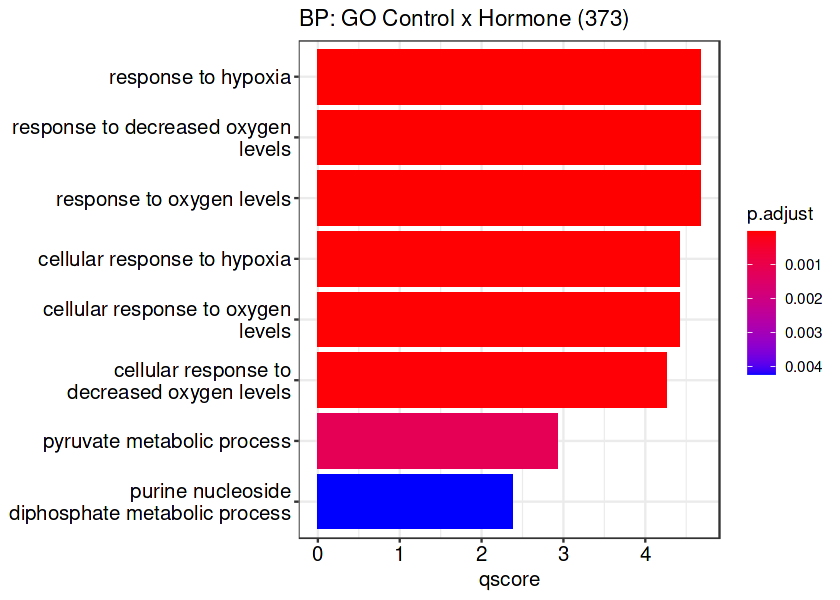

In [117]:
title = paste0("BP: GO Control x Hormone (", ngenes, ")")

plot.width = 7
plot.height = 5
options(repr.plot.width = plot.width, repr.plot.height = plot.height)
go_func2(hormone_converted_genes, title) 
#ggsave(file="results/2023-01/GO_Pre1_EMO6_con_x_hor_2.pdf", width = plot.width, height = plot.height) 

In [118]:
sessionInfo()

R version 4.2.2 Patched (2022-11-10 r83330)
Platform: x86_64-pc-linux-gnu (64-bit)
Running under: Ubuntu 20.04.5 LTS

Matrix products: default
BLAS:   /usr/lib/x86_64-linux-gnu/atlas/libblas.so.3.10.3
LAPACK: /usr/lib/x86_64-linux-gnu/atlas/liblapack.so.3.10.3

locale:
 [1] LC_CTYPE=C.UTF-8       LC_NUMERIC=C           LC_TIME=C.UTF-8       
 [4] LC_COLLATE=C.UTF-8     LC_MONETARY=C.UTF-8    LC_MESSAGES=C.UTF-8   
 [7] LC_PAPER=C.UTF-8       LC_NAME=C              LC_ADDRESS=C          
[10] LC_TELEPHONE=C         LC_MEASUREMENT=C.UTF-8 LC_IDENTIFICATION=C   

attached base packages:
[1] stats4    stats     graphics  grDevices utils     datasets  methods  
[8] base     

other attached packages:
 [1] sctransform_0.3.5     forcats_0.5.2         stringr_1.5.0        
 [4] purrr_1.0.1           readr_2.1.3           tidyr_1.3.0          
 [7] tibble_3.2.1          tidyverse_1.3.2       AnnotationHub_3.6.0  
[10] BiocFileCache_2.6.0   dbplyr_2.3.0          org.Hs.eg.db_3.16.0  
[13] Annota